In [542]:
########################################################################
#
#   Who      : Tze Goh
#   Filename : exploreHalo02_Tze
#   What     : This File is attempting to debug 2 files :
#              halo02_msto_subsample.ebf
#              halo02.dat 
#
########################################################################

In [543]:
import numpy as np
from matplotlib import pyplot as pl
import numpy.ma as ma
import matplotlib

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
plt.rcParams['figure.figsize']=(18,18)
from astropy import units as u
from astropy.coordinates import SkyCoord

%matplotlib inline

In [544]:
import ebf

In [545]:
data=ebf.read('/Users/TzeGoh/Galaxia/Run/halo02_msto_subsample.ebf')

In [546]:
data.keys()

['rad',
 'exbv_solar',
 'teff',
 'mag2',
 'mag1',
 'mag0',
 'dcmc_h',
 'dcmc_i',
 'dcmc_j',
 'satid',
 'vx',
 'vy',
 'vz',
 'mtip',
 'log',
 'pz',
 'px',
 'py',
 'feh',
 'dcmc_ks',
 'exbv_schlegel',
 'lum',
 'exbv_schlegel_inf',
 'mact',
 'glon',
 'popid',
 'glat',
 'alpha',
 'center',
 'partid',
 'age',
 'grav',
 'smass',
 'fieldid']

In [547]:
len(data['lum'])

18208538

In [548]:
sp = ebf.read('/Users/TzeGoh/Galaxia/Run/satprop.ebf')

In [549]:
sp.keys()

['jsat', 'log', 'msat', 'bsat', 'nsat', 'esat', 'tsat', 'nsatc', 'lsat']

In [550]:
print(data['log'])

[ '# File generated by 0.7.1\n# <parameterfile>\noutputFile                          halo02\noutputDir                           /Users/robyn/Documents/Research/ColumbiaUndergrads/Galaxia/\nphotoSys                            DCMC\nmagcolorNames                       Ks,J-Ks\nappMagLimits[0]                     -1000\nappMagLimits[1]                     24.5\nabsMagLimits[0]                     -1000\nabsMagLimits[1]                     1000\ncolorLimits[0]                      0\ncolorLimits[1]                      1\ngeometryOption                      0\nstarType                            0\nphotoError                          0\nsurveyArea                          207.455\nfSample                             0.01\npopID                               10\nwarpFlareOn                         0\nlongitude                           76.273\nlatitude                            13.4725\nseed                                17\nr_max                               1000\n# codeDataDir        

In [551]:
#gxutil.abs2app(data,corr=True,noext=True,dered=True)

In [552]:
#gxutil.append_pm(data)

In [553]:
mwd = np.zeros_like(data['grav'],dtype=bool)
mwd[data['grav']<2]=True

In [554]:
d = np.sqrt(data['px']**2+data['py']**2+data['pz']**2)

In [555]:
'''Let us match the satellite...This indexes from 0 - 112'''
those_satid_numbs = []
for i in range(len(data['satid'])):
    if data['satid'][i] not in those_satid_numbs:
        those_satid_numbs.append(data['satid'][i])  

In [556]:
'''What are those satids for the ebf file'''
print those_satid_numbs

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112]


In [557]:
########################################################################
#
#   Getting the Masses of Galaxies the EBF File
#
########################################################################

In [558]:
'''Let us match up satellite number to the total mass of each satellite'''

dict_of_satid_n_ave_mass = []
all_mass = 0
k=0
print len(data['satid'])

for i in range(len(those_satid_numbs)):
    ######print i
    for j in range(k, len(data['satid'])):
        if data['satid'][j] == i:
            all_mass = all_mass + data['smass'][j]
        else :
            k = j
            break   
    dict_of_satid_n_ave_mass.append([i+1, all_mass])
    all_mass = 0

#print dict_of_satid_n_ave_mass   
         

18208538


In [559]:
'''Tell me the satid of the 10 lowest mass and 10 higest mass satellite -- EBF'''

lowest_mass = []
lowest_id = []
list_of_mass = []
for i in range(len(those_satid_numbs)):
    list_of_mass.append(dict_of_satid_n_ave_mass[i][1] )
#print list_of_mass
for i in range(10):
    low = min(list_of_mass)
    lowest_mass.append(low)
    list_of_mass.remove(low)
    
#print lowest_mass
for i in range(len(dict_of_satid_n_ave_mass)):
    for j in range(len(lowest_mass)):
        if lowest_mass[j] == dict_of_satid_n_ave_mass[i][1]:
            lowest_id.append(dict_of_satid_n_ave_mass[i][0])

highest_mass = []
highest_id = []
list_of_mass = []
for i in range(len(those_satid_numbs)):
    list_of_mass.append(dict_of_satid_n_ave_mass[i][1] )
#print list_of_mass
for i in range(10):
    high = max(list_of_mass)
    highest_mass.append(high)
    list_of_mass.remove(high)
    
#print lowest_mass
for i in range(len(dict_of_satid_n_ave_mass)):
    for j in range(len(highest_mass)):
        if highest_mass[j] == dict_of_satid_n_ave_mass[i][1]:
            highest_id.append(dict_of_satid_n_ave_mass[i][0])
            
            
print 'These are the lowest mass satellite:', lowest_id
print 'These are the highest mass satellite:', highest_id
      

These are the lowest mass satellite: [1, 2, 11, 95, 106, 107, 109, 111, 112, 113]
These are the highest mass satellite: [26, 35, 36, 37, 40, 41, 50, 55, 67, 81]


In [560]:
'''Generate a code to automize the start and end of particle number of each satid,'The dictionary is : satid,start,finish'''
def dict__ranges_EBF(data):
    k=0
    l=0
    dict_of_ranges_EBF = []
    for i in range(len(data['satid'])):
        if data['satid'][i]!=k:
            dict_of_ranges_EBF.append([k,l,i])
            l=i
            k=k+1   
    dict_of_ranges_EBF.append([112,l,len(data['satid'])-1])
    return dict_of_ranges_EBF
     

In [561]:
########################################################################
#
#   Getting the position of Satellite Numbers from the EBF File
#
########################################################################

In [562]:
'''For all the satellites in EBF, I am going to get their : x position, y position, z position and mass. All in galactic coords
'''
a = dict__ranges_EBF(data)
#print a
b = len(a)
#print b

In [563]:
print data['center'][5]

7.25


In [564]:
'''For all the satellites in EBF, I am going to get their : x position, 
y position, z position and mass. All in galactic coords......INFO_EBF!!!!!!'''

dict__objs_al = []

for j in range(b):
    identity = a[j][0]
    start = a[j][1]
    end =  a[j][2]
    dict__objs_al.append([])
    sat__ebf_px = []
    sat__ebf_py = []
    sat__ebf_pz = []
    sat__ebf_mass = []
    sat__ebf_vx = []
    sat__ebf_vy = []
    sat__ebf_vz = [] 
    
    for i in range(start,end):   
        sat__ebf_px.append(data['px'][i]+data['center'][0])
        sat__ebf_py.append(data['py'][i]+data['center'][1])
        sat__ebf_pz.append(data['pz'][i]+data['center'][2])
        sat__ebf_mass.append(data['smass'][i])
        sat__ebf_vx.append(data['vx'][i]+data['center'][3])
        sat__ebf_vy.append(data['vy'][i]+data['center'][4])
        sat__ebf_vz.append(data['vz'][i]+data['center'][5])
        
    dict__objs_al[j].append(sat__ebf_px)
    dict__objs_al[j].append(sat__ebf_py)
    dict__objs_al[j].append(sat__ebf_pz)
    dict__objs_al[j].append(sat__ebf_mass)
    dict__objs_al[j].append(sat__ebf_vx)
    dict__objs_al[j].append(sat__ebf_vy)
    dict__objs_al[j].append(sat__ebf_vz)

info_EBF = dict__objs_al
info_EBF.insert(0,[0,0,0,0,0,0,0])

In [565]:
########################################################################
#
#   Getting the Satellite Numbers from the DAT File
#
########################################################################

In [566]:
'''Opening the DAT File'''
f = open('halo02.dat')
hel = []
for line in f:
    hel.append(line)
    

In [567]:
'''Appending the DAT File into a list ... this list indexes from 0 to 112'''
length = len(hel)
flow = []
for i in range(length):
    floats = [float(x) for x in hel[i].split()]
    flow.append(floats)    

those_satid_numbs_for_DAT_file = []
for i in range(length):
    if flow[i][0] not in those_satid_numbs_for_DAT_file:
        those_satid_numbs_for_DAT_file.append(flow[i][0])

In [568]:
'''Tell me what those satid file is for the DAT file'''
print those_satid_numbs_for_DAT_file

[1.0, 2.0, 3.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0, 16.0, 17.0, 18.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0, 53.0, 54.0, 55.0, 56.0, 57.0, 58.0, 59.0, 60.0, 61.0, 62.0, 63.0, 64.0, 65.0, 66.0, 67.0, 68.0, 69.0, 70.0, 71.0, 72.0, 73.0, 74.0, 75.0, 76.0, 77.0, 78.0, 79.0, 80.0, 81.0, 82.0, 83.0, 84.0, 85.0, 86.0, 87.0, 88.0, 89.0, 90.0, 91.0, 92.0, 93.0, 94.0, 95.0, 96.0, 97.0, 98.0, 99.0, 100.0, 101.0, 102.0, 103.0, 104.0, 105.0, 106.0, 107.0, 108.0, 109.0, 110.0, 111.0, 112.0, 113.0]


In [569]:
'''Let us match up satellite number to the total mass of each satellite'''

dict_of_satid_n_mass_DAT = []
temp_mass = 0
k=0
for j in range(1,114):
    #print j
    for i in range(k,len(flow)):
        if flow[i][0] == j:
            temp_mass = temp_mass + flow[i][13]
            k=k+1
        else:
            break
    dict_of_satid_n_mass_DAT.append([j,temp_mass])
    temp_mass = 0
      

In [570]:
'''Tell me the satid of the 10 lowest mass and 10 higest mass satellite -- DAT'''

lowest_mass = []
lowest_id_DAT = []
list_of_mass = []
for i in range(len(dict_of_satid_n_mass_DAT)):
    list_of_mass.append(dict_of_satid_n_mass_DAT[i][1] )
#print list_of_mass
for i in range(10):
    low = min(list_of_mass)
    lowest_mass.append(low)
    list_of_mass.remove(low)
    
#print lowest_mass
for i in range(len(dict_of_satid_n_mass_DAT)):
    for j in range(len(lowest_mass)):
        if lowest_mass[j] == dict_of_satid_n_mass_DAT[i][1]:
            lowest_id_DAT.append(dict_of_satid_n_mass_DAT[i][0])

highest_mass = []
highest_id_DAT = []
list_of_mass = []
for i in range(len(dict_of_satid_n_mass_DAT)):
    list_of_mass.append(dict_of_satid_n_mass_DAT[i][1] )
#print list_of_mass
for i in range(10):
    high = max(list_of_mass)
    highest_mass.append(high)
    list_of_mass.remove(high)
    
#print lowest_mass
for i in range(len(dict_of_satid_n_mass_DAT)):
    for j in range(len(highest_mass)):
        if highest_mass[j] == dict_of_satid_n_mass_DAT[i][1]:
            highest_id_DAT.append(dict_of_satid_n_mass_DAT[i][0])
            
            
print 'These are the lowest mass satellite:', lowest_id

print 'These are the highest mass satellite:', highest_id
  
    

These are the lowest mass satellite: [1, 2, 11, 95, 106, 107, 109, 111, 112, 113]
These are the highest mass satellite: [26, 35, 36, 37, 40, 41, 50, 55, 67, 81]


In [571]:
'''Let me automate the whole process of finding position and mass. It is indexed 0,1,2....113 for a total of 114 objs
There is x-coords, y-coords,z-coords and mass ........INFO_DAT!!!!!!!'''
all_pos_n_mass_DAT = []
sat_dat=[]
x = []
y = []
z = []
m = []
vx = []
vy = []
vz = []

def DAT_satellite_pos_and_mass(p):
    for i in range(len(flow)):
        if flow[i][0] == p:
            sat_dat.append(flow[i])
        
    length = len(sat_dat)

    for i in range(length):
        x.append(sat_dat[i][1])
        y.append(sat_dat[i][2])
        z.append(sat_dat[i][3])
        m.append(sat_dat[i][13])
        vx.append(sat_dat[i][4])
        vy.append(sat_dat[i][5])
        vz.append(sat_dat[i][6])
    
    return x,y,z,m,vx,vy,vz

#a=DAT_satellite_pos_and_mass(p)


all_pos_n_mass_DAT.append([0,0,0,0,0,0,0])
for j in range(1,114):
    p=j
    info = DAT_satellite_pos_and_mass(p)
    all_pos_n_mass_DAT.append(info)
    
    sat_dat=[]
    x = []
    y = []
    z = []
    m = []
    vx = []
    vy = []
    vz = []
    

info_DAT = all_pos_n_mass_DAT    

    

In [572]:
#########################################################################################################
#
#    And now, let's plot all the galaxies out from these 2 files to make sure that they are the same 
#
#########################################################################################################

In [573]:
'''Plot me ALL Satellite 2d '''

def plot_me(p,xstart,xend,ystart,yend,zstart,zend):
    
    title = 'Satelite',p
    side_title = 'Orange is EBF, Grey is DAT'
    plt.rcParams['figure.figsize']=(15,6)
    fig,ax = plt.subplots(1,2)
    
    ax[0].plot(info_DAT[p][0],info_DAT[p][1],'o',ms=3,alpha=0.05,color='none',mec='grey')
    ax[0].plot(info_EBF[p][0],info_EBF[p][1],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0].set_title(title)
    ax[0].set_ylabel(side_title)
    ax[0].set_xlim(xstart,xend)
    ax[0].set_ylim(ystart,yend)

    ax[1].plot(info_DAT[p][0],info_DAT[p][2],'o',ms=3,alpha=0.05,color='none',mec='grey')
    ax[1].plot(info_EBF[p][0],info_EBF[p][2],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[1].set_title(title)
    ax[1].set_xlim(xstart,xend)
    ax[1].set_ylim(zstart,zend)

In [574]:
'''Plot me 1 Satellite 2d along with its histogram'''
import matplotlib.patches as patches
def plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                       xlow,xupp,ylow,yupp,zlow,zupp):
    
    x_hist = [i for i in info_DAT[p][0] if i>=xlow and i<=xupp]
    y_hist = [i for i in info_DAT[p][1] if i>=ylow and i<=yupp]
    z_hist = [i for i in info_DAT[p][2] if i>=zlow and i<=zupp]
    m_hist_y = []
    for i in range(len(info_DAT[p][1])):
        if info_DAT[p][1][i] >= ylow and info_DAT[p][1][i]<=yupp:
            m_hist_y.append(info_DAT[p][3][i])
    m_hist_z = []
    for i in range(len(info_DAT[p][2])):
        if info_DAT[p][2][i] >= zlow and info_DAT[p][2][i]<=zupp:
            m_hist_z.append(info_DAT[p][3][i])
           
    x_al_hist = [i for i in info_EBF[p][0] if i>=xlow and i<=xupp]
    y_al_hist = [i for i in info_EBF[p][1] if i>=ylow and i<=yupp]
    z_al_hist = [i for i in info_EBF[p][2] if i>=zlow and i<=zupp]
    m_al_hist_y = []
    for i in range(len(info_EBF[p][1])):
        if info_EBF[p][1][i] >= ylow and info_EBF[p][1][i]<=yupp:
            m_al_hist_y.append(info_EBF[p][3][i])
    m_al_hist_z = []
    for i in range(len(info_EBF[p][2])):
        if info_EBF[p][2][i] >= zlow and info_EBF[p][2][i]<=zupp:
            m_al_hist_z.append(info_EBF[p][3][i])
    
    
    
    title = 'Satelite',p
    side_title = 'Orange is EBF, Grey is DAT'
    plt.rcParams['figure.figsize']=(15,12)
    fig,ax = plt.subplots(3,2)
    

    ax[0,0].plot(info_DAT[p][0],info_DAT[p][1],'o',ms=3,alpha=0.05,color='none',mec='grey')   # y vs x
    ax[0,0].plot(info_EBF[p][0],info_EBF[p][1],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,0].set_title(title)
    ax[0,0].set_ylabel(side_title)
    ax[0,0].set_xlim(xstart,xend)
    ax[0,0].set_ylim(ystart,yend)
    ax[0,0].add_patch(
            patches.Rectangle(
            (xlow, ylow),       # (x,y)
             xupp-xlow,         # width
             yupp-ylow,          # height
             facecolor = 'None',alpha=0.4,linewidth=2
            )
    )
    #across y_hist
    hist_low = ylow - (yupp-ylow)/10                                                                                                                              
    hist_upp = yupp + (yupp-ylow)/10      
    bins = np.linspace(hist_low,hist_upp,20)                  
    ax[1,0].hist(y_al_hist,normed=True, bins = bins, histtype='step',                       
                 color = 'orange', alpha = 0.8, linewidth=3) 
    ax[1,0].set_title(' unweighted y ')
    ax[1,0].hist(y_hist,normed=True, bins = bins,histtype='step',color = 'grey',alpha = 0.5, linewidth=3)
    
    ax[2,0].set_title(' weighted y ')
    ax[2,0].hist(y_hist, histtype='step', color = 'grey',alpha = 0.5, linewidth=3)
    ax[2,0].hist(y_al_hist, histtype='step', bins=bins, color = 'orange', alpha = 1,linewidth=3,weights = m_al_hist_y )
    
    
    
     
    ax[0,1].plot(info_DAT[p][0],info_DAT[p][2],'o',ms=3,alpha=0.05,color='none',mec='grey')  # z vs x
    ax[0,1].plot(info_EBF[p][0],info_EBF[p][2],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,1].set_title(title)
    ax[0,1].set_xlim(xstart,xend)
    ax[0,1].set_ylim(zstart,zend)
    ax[0,1].add_patch(
            patches.Rectangle(
            (xlow, zlow),       # (x,y)
             xupp-xlow,         # width
             zupp-zlow,          # height
             facecolor = 'None',alpha=0.4,linewidth=2
            )
    )
    # across z_hist
    hist_low = zlow - (zupp-zlow)/10
    hist_upp = zupp + (zupp-zlow)/10
    bins = np.linspace(hist_low,hist_upp,20)
    ax[1,1].hist(z_al_hist,normed=True, bins = bins, histtype='step',                       
                 color = 'orange', alpha = 0.8, linewidth=3) 
    ax[1,1].set_title(' unweighted z ')
    ax[1,1].hist(z_hist,normed=True, bins = bins,histtype='step',color = 'grey',alpha = 0.5,linewidth=3)
    ax[2,1].set_title(' weighted z ')
    ax[2,1].hist(z_hist, histtype='step', color = 'grey',alpha = 0.5,  linewidth=3)
    ax[2,1].hist(z_al_hist, histtype='step', bins=bins, color = 'orange', alpha = 1,linewidth=3,weights = m_al_hist_z  )

In [575]:
'''The whole DAT file and the EBF file  '''

x_al = []
y_al = []
z_al = []
for i in range(1,len(info_EBF)):          # This is EBF
    for j in range(len(info_EBF[i][0])):
        x_al.append(info_EBF[i][0][j])
        y_al.append(info_EBF[i][1][j])
        z_al.append(info_EBF[i][2][j])
       
length = len(hel)                          # This is DAT                                                
x = []
y = []
z = []
for i in range(length):
    x.append(flow[i][1])
    y.append(flow[i][2])
    z.append(flow[i][3])

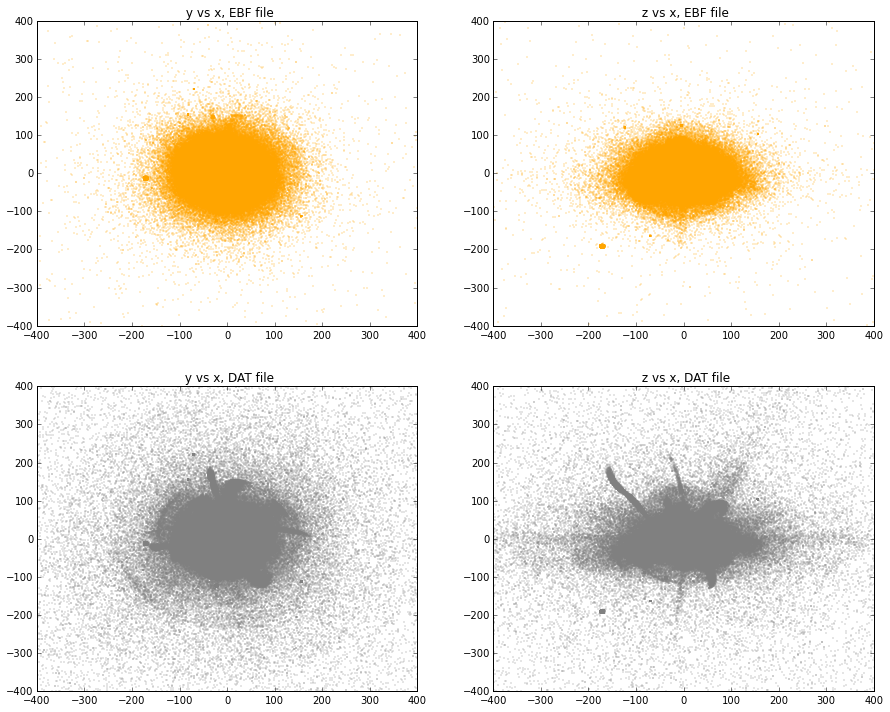

In [607]:
'''The plot for the whole DAT file and the EBF file in y vs x, and z vs x '''
plt.rcParams['figure.figsize']=(15,12)
fig,ax = plt.subplots(2,2)

ax[0,0].plot(x_al,y_al,'o',alpha=0.01,color='none',mec='orange',ms=0.5)
ax[0,0].set_title(' y vs x, EBF file')
ax[0,0].set_xlim(-400,400)
ax[0,0].set_ylim(-400,400)

ax[0,1].plot(x_al,z_al,'o',alpha=0.01,color='none',mec='orange',ms=0.5)
ax[0,1].set_title(' z vs x, EBF file')
ax[0,1].set_xlim(-400,400)
ax[0,1].set_ylim(-400,400)

ax[1,0].plot(x,y,'o',alpha=0.01,color='none',mec='grey',ms=0.5)
ax[1,0].set_title(' y vs x, DAT file')
ax[1,0].set_xlim(-400,400)
ax[1,0].set_ylim(-400,400)

ax[1,1].plot(x,z,'o',alpha=0.01,color='none',mec='grey',ms=0.5)
ax[1,1].set_title(' z vs x, DAT file')
ax[1,1].set_xlim(-400,400)
ax[1,1].set_ylim(-400,400)
fig.savefig('All_Sky.png', bbox_inches='tight')
plt.figure()

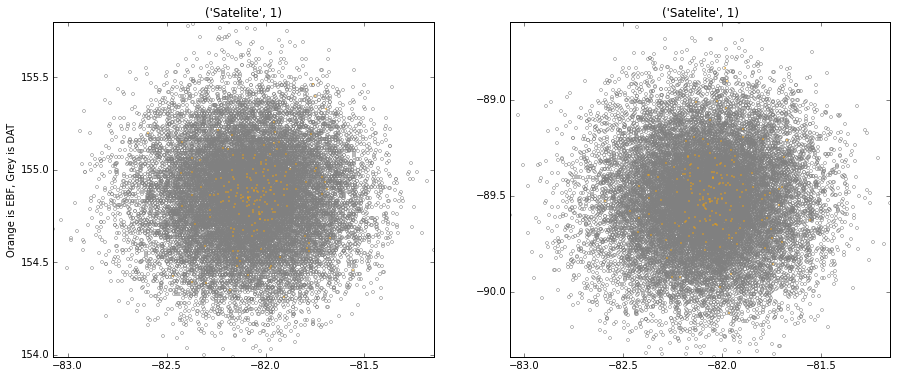

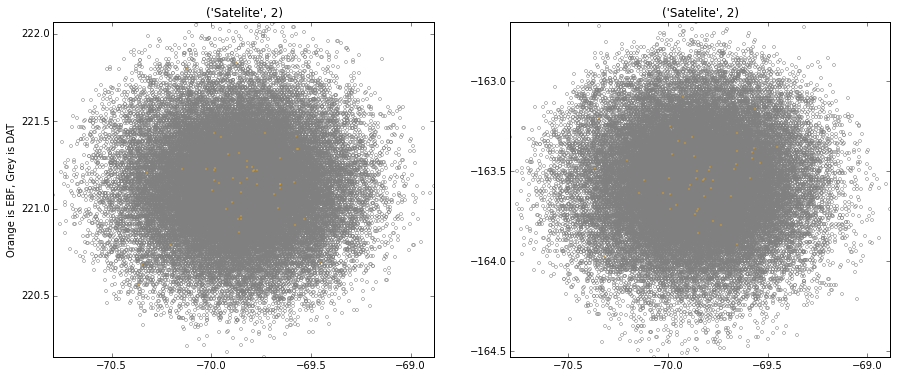

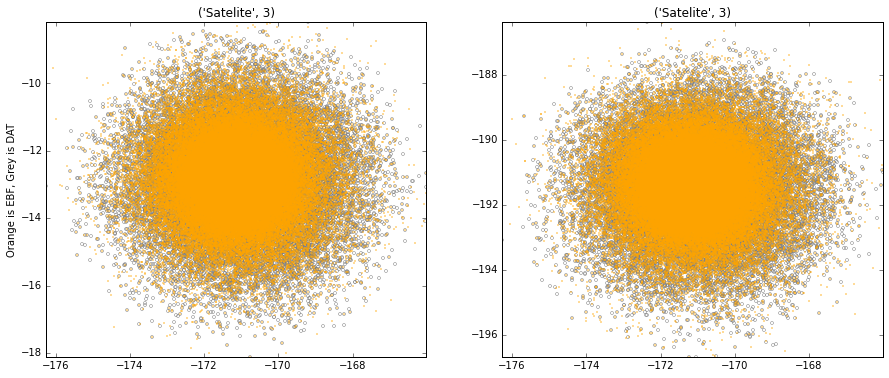

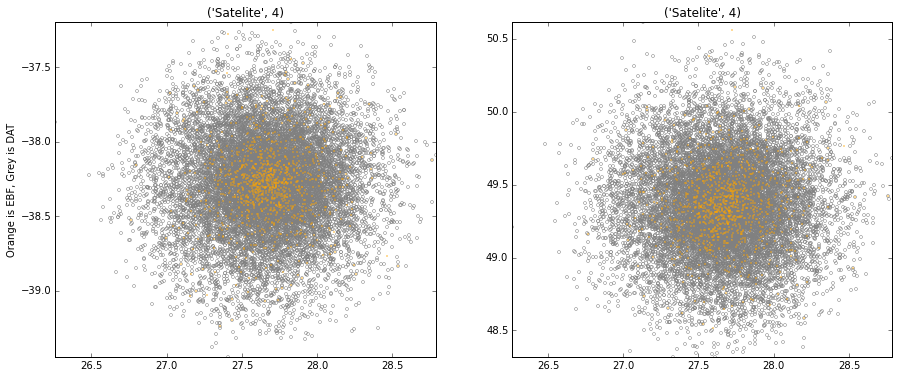

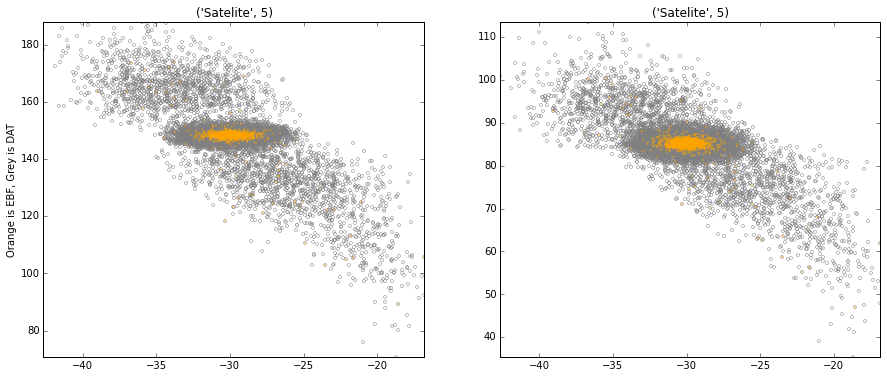

...

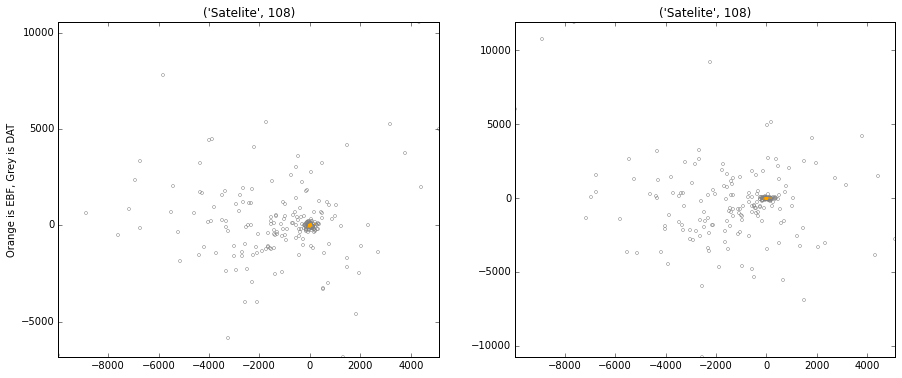

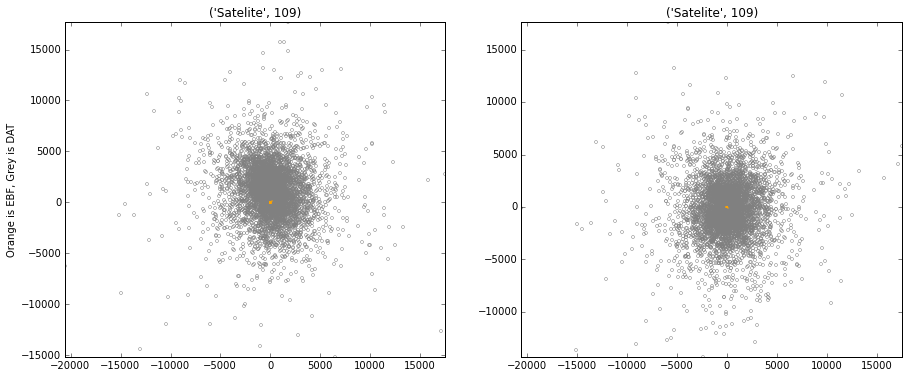

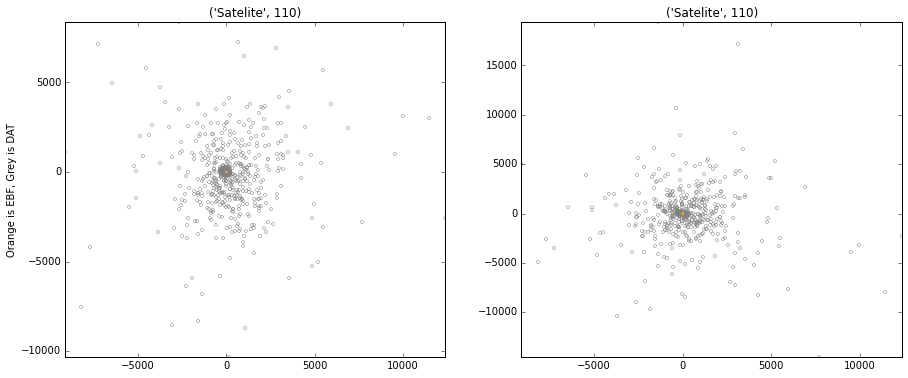

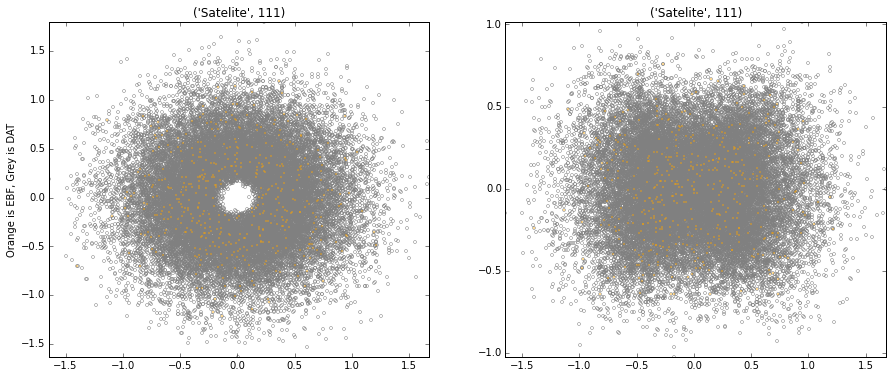

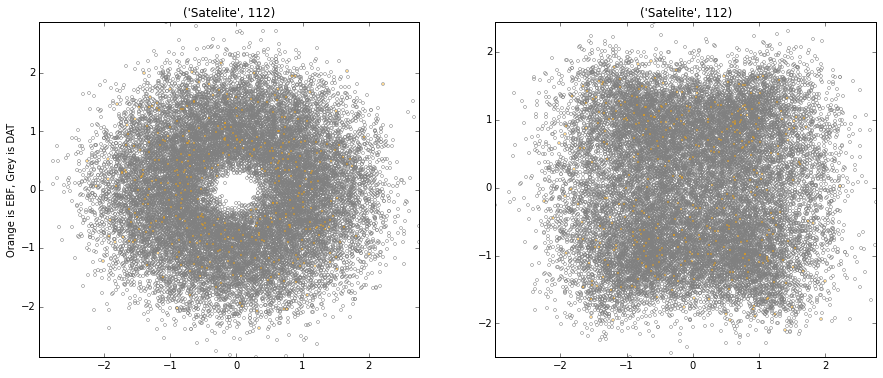

In [609]:
'''Plots all the plot out in 2D : BOTH EDF AND DAT'''

for p in range(1,113):
    [xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),
                                           min(info_DAT[p][1]),max(info_DAT[p][1]),
                                           min(info_DAT[p][2]),max(info_DAT[p][2])]
    plot_me(p,xstart,xend,ystart,yend,zstart,zend)
    
    plt.figure()

In [578]:
'''Plot me 1 Satellite 2d along with its histogram....This is wrong ...TO BE DELETED'''
import matplotlib.patches as patches
def plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                       xlow,xupp,ylow,yupp,zlow,zupp):
    
    x_hist = [i for i in info_DAT[p][0] if i>=xlow and i<=xupp]
    y_hist = [i for i in info_DAT[p][1] if i>=ylow and i<=yupp]
    z_hist = [i for i in info_DAT[p][2] if i>=zlow and i<=zupp]
    m_hist_y = []
    for i in range(len(info_DAT[p][1])):
        if info_DAT[p][1][i] >= ylow and info_DAT[p][1][i]<=yupp:
            m_hist_y.append(info_DAT[p][3][i])
    m_hist_z = []
    for i in range(len(info_DAT[p][2])):
        if info_DAT[p][2][i] >= zlow and info_DAT[p][2][i]<=zupp:
            m_hist_z.append(info_DAT[p][3][i])
           
    x_al_hist = [i for i in info_EBF[p][0] if i>=xlow and i<=xupp]
    y_al_hist = [i for i in info_EBF[p][1] if i>=ylow and i<=yupp]
    z_al_hist = [i for i in info_EBF[p][2] if i>=zlow and i<=zupp]
    m_al_hist_y = []
    for i in range(len(info_EBF[p][1])):
        if info_EBF[p][1][i] >= ylow and info_EBF[p][1][i]<=yupp:
            m_al_hist_y.append(info_EBF[p][3][i])
    m_al_hist_z = []
    for i in range(len(info_EBF[p][2])):
        if info_EBF[p][2][i] >= zlow and info_EBF[p][2][i]<=zupp:
            m_al_hist_z.append(info_EBF[p][3][i])
    
    title = 'Satelite',p
    side_title = 'Orange is EBF, Grey is DAT'
    plt.rcParams['figure.figsize']=(15,12)
    fig,ax = plt.subplots(3,2)
    
    # y vs x
    ax[0,0].plot(info_DAT[p][0],info_DAT[p][1],'o',ms=3,alpha=0.05,color='none',mec='grey')   
    ax[0,0].plot(info_EBF[p][0],info_EBF[p][1],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,0].set_title(title)
    ax[0,0].set_ylabel(side_title)
    ax[0,0].set_xlim(xstart,xend)
    ax[0,0].set_ylim(ystart,yend)
    ax[0,0].add_patch(
            patches.Rectangle(
            (xlow, ylow),       # (x,y)
             xupp-xlow,         # width
             yupp-ylow,          # height
             facecolor = 'None',color = 'cyan',alpha=0.4,linewidth=2
            )
    )
    #across y_hist
    hist_low_y = ylow - (yupp-ylow)/10                                                                                                                              
    hist_upp_y = yupp + (yupp-ylow)/10      
    bins = np.linspace(hist_low_y,hist_upp_y,20)
    ax[1,0].set_title(' unweighted y ')
    ax[1,0].hist(y_al_hist,normed=True, bins = bins, histtype='step',                       
                 color = 'orange', alpha = 0.8, linewidth=3) 
    ax[1,0].hist(y_hist,normed=True, bins = bins,histtype='step',color = 'grey',
                 alpha = 0.5, linewidth=3 
                )
    ax[2,0].set_title(' weighted y ')
    ax[2,0].hist(y_hist, histtype='step', color = 'grey',alpha = 0.5, linewidth=3)
    ax[2,0].hist(y_al_hist,           bins = bins,histtype='step', color = 'orange', 
                 alpha = 1, linewidth=3, weights = m_al_hist_y 
                )
    
    
    
    # z vs x
    ax[0,1].plot(info_DAT[p][0],info_DAT[p][2],'o',ms=3,alpha=0.05,color='none',mec='grey')  
    ax[0,1].plot(info_EBF[p][0],info_EBF[p][2],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,1].set_title(title)
    ax[0,1].set_xlim(xstart,xend)
    ax[0,1].set_ylim(zstart,zend)
    ax[0,1].add_patch(
            patches.Rectangle(
            (xlow, zlow),       # (x,y)
             xupp-xlow,         # width
             zupp-zlow,          # height
             facecolor = 'None',alpha=0.4,linewidth=2
            )
    )
    # across z_hist
    hist_low_z = zlow - (zupp-zlow)/10
    hist_upp_z= zupp + (zupp-zlow)/10
    bins = np.linspace(hist_low_z,hist_upp_z,20)
    ax[1,1].hist(z_al_hist,normed=True, bins = bins, histtype='step',                       
                 color = 'orange', alpha = 0.8, linewidth=3) 
    ax[1,1].set_title(' unweighted z ')
    ax[1,1].hist(z_hist,normed=True, bins = bins, histtype='step',color = 'grey',
                 alpha = 0.5,linewidth=3
                )
    ax[2,1].set_title(' weighted z ')
    ax[2,1].hist(z_hist, histtype='step', color = 'grey',alpha = 0.5,  linewidth=3)
    ax[2,1].hist(z_al_hist,          bins = bins, histtype='step', color = 'orange', 
                 alpha = 1, linewidth=3, weights = m_al_hist_z  
                )

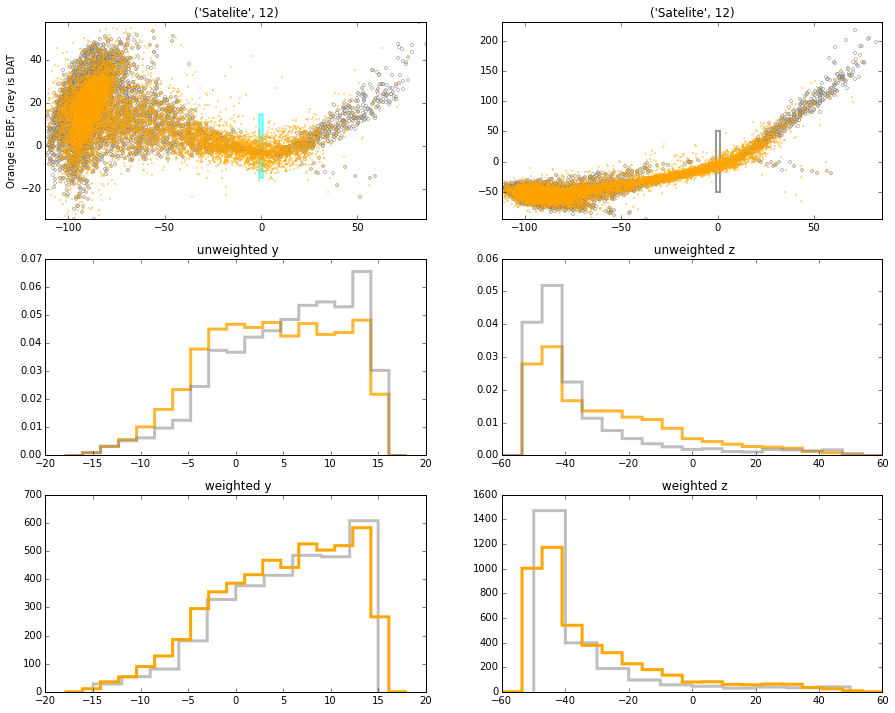

In [579]:
'''Plotting individual satellites with histogram...This is wrong ...TO BE DELETED'''
p=12
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,1,   # The limits of the box you look at
                                 -15,15,
                                 -50,50]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)
plt.figure()

In [580]:
'''Plot me 1 Satellite 2d along with its histogram'''
import matplotlib.patches as patches
def plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                       xlow,xupp,ylow,yupp,zlow,zupp):
    
    x_hist = []
    y_hist = []
    z_hist = []
    m_hist_y = []
    m_hist_z = []
         
    for i in range(len(info_DAT[p][0])):
        if info_DAT[p][0][i] >= xlow and info_DAT[p][0][i]<=xupp:
            if info_DAT[p][1][i] >= ylow and info_DAT[p][1][i]<=yupp:
                y_hist.append(info_DAT[p][1][i])
                m_hist_y.append(info_DAT[p][3][i])
            if info_DAT[p][2][i] >= zlow and info_DAT[p][2][i]<=zupp:
                z_hist.append(info_DAT[p][2][i])
                m_hist_z.append(info_DAT[p][3][i])
           
    x_al_hist = []
    y_al_hist = []
    z_al_hist = []
    m_al_hist_y = []
    m_al_hist_z = []
    
    for i in range(len(info_EBF[p][0])):
        if info_EBF[p][0][i] >= xlow and info_EBF[p][0][i]<=xupp:
            if info_EBF[p][1][i] >= ylow and info_EBF[p][1][i]<=yupp:
                y_al_hist.append(info_EBF[p][1][i])
                m_al_hist_y.append(info_EBF[p][3][i])
            if info_EBF[p][2][i] >= zlow and info_EBF[p][2][i]<=zupp:
                z_al_hist.append(info_EBF[p][2][i])
                m_al_hist_z.append(info_EBF[p][3][i])
    
    
    
    title = 'Satelite',p
    side_title = 'Orange is EBF, Grey is DAT'
    plt.rcParams['figure.figsize']=(15,12)
    fig,ax = plt.subplots(3,2)
    
    # y vs x
    ax[0,0].plot(info_DAT[p][0],info_DAT[p][1],'o',ms=3,alpha=0.05,color='none',mec='grey')   
    ax[0,0].plot(info_EBF[p][0],info_EBF[p][1],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,0].set_title(title)
    ax[0,0].set_ylabel(side_title)
    ax[0,0].set_xlim(xstart,xend)
    ax[0,0].set_ylim(ystart,yend)
    ax[0,0].add_patch(
            patches.Rectangle(
            (xlow, ylow),       # (x,y)
             xupp-xlow,         # width
             yupp-ylow,          # height
             facecolor = 'None',edgecolor = 'red',alpha=0.8,linewidth=5
            )
    )
    #across y_hist
    hist_low_y = ylow - (yupp-ylow)/10                                                                                                                              
    hist_upp_y = yupp + (yupp-ylow)/10      
    bins = np.linspace(hist_low_y,hist_upp_y,20)
    ax[1,0].set_title(' unweighted y ')
    ax[1,0].hist(y_hist,          #DAT
                 normed=True, 
                 bins = bins,
                 histtype='step',
                 color = 'grey',
                 alpha = 0.5, 
                 linewidth=3 )
    ax[1,0].hist(y_al_hist,       #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'orange',
                 alpha = 0.8, 
                 linewidth=3) 

           
    ax[2,0].set_title(' weighted y ')
    ax[2,0].hist(y_hist,          #DAT
                 normed=True, 
                 bins = bins, 
                 histtype='step', 
                 color = 'grey',
                 alpha = 0.5, 
                 linewidth=3
                 ,weights = m_hist_y 
                )
    ax[2,0].hist(y_al_hist,       #EBF
                 normed=True,
                 bins = bins,
                 histtype='step', 
                 color = 'orange', 
                 alpha = 1, 
                 linewidth=3
                 #,weights = m_al_hist_y
                 )
    
    
    
    # z vs x
    ax[0,1].plot(info_DAT[p][0],info_DAT[p][2],'o',ms=3,alpha=0.05,color='none',mec='grey')  
    ax[0,1].plot(info_EBF[p][0],info_EBF[p][2],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,1].set_title(title)
    ax[0,1].set_xlim(xstart,xend)
    ax[0,1].set_ylim(zstart,zend)
    ax[0,1].add_patch(
            patches.Rectangle(
            (xlow, zlow),       # (x,y)
             xupp-xlow,         # width
             zupp-zlow,          # height
             facecolor = 'None',edgecolor = 'red',alpha=0.8,linewidth=5
            )
    )
    # across z_hist
    hist_low_z = zlow - (zupp-zlow)/10
    hist_upp_z= zupp + (zupp-zlow)/10
    bins = np.linspace(hist_low_z,hist_upp_z,20)
    ax[1,1].set_title(' unweighted z ')
    ax[1,1].hist(z_hist,         #DAT
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'grey',
                 alpha = 0.5,
                 linewidth=3)
    ax[1,1].hist(z_al_hist,      #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'orange', 
                 alpha = 0.8, 
                 linewidth=3) 
    
    ax[2,1].set_title(' weighted z ')
    ax[2,1].hist(z_hist,         #DAT
                 normed=True, 
                 bins = bins,
                 histtype='step', 
                 color = 'grey',
                 alpha = 0.5,  
                 linewidth=3
                 ,weights = m_hist_z
                )
    ax[2,1].hist(z_al_hist,      #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step', 
                 color = 'orange', 
                 alpha = 1, 
                 linewidth=3
                 #,weights = m_al_hist_z
                
                )


In [581]:
'''Plot me 1 Satellite 2d along with its histogram IN VELOCITY SPACE'''
import matplotlib.patches as patches
def plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                       xlow,xupp,ylow,yupp,zlow,zupp):
    
    x_hist = []
    y_hist = []
    z_hist = []
    m_hist_y = []
    m_hist_z = []
         
    for i in range(len(info_DAT[p][4])):
        if info_DAT[p][4][i] >= xlow and info_DAT[p][4][i]<=xupp:
            if info_DAT[p][5][i] >= ylow and info_DAT[p][5][i]<=yupp:
                y_hist.append(info_DAT[p][5][i])
                m_hist_y.append(info_DAT[p][3][i])
            if info_DAT[p][6][i] >= zlow and info_DAT[p][6][i]<=zupp:
                z_hist.append(info_DAT[p][6][i])
                m_hist_z.append(info_DAT[p][3][i])
           
    x_al_hist = []
    y_al_hist = []
    z_al_hist = []
    m_al_hist_y = []
    m_al_hist_z = []
    
    for i in range(len(info_EBF[p][4])):
        if info_EBF[p][4][i] >= xlow and info_EBF[p][4][i]<=xupp:
            if info_EBF[p][5][i] >= ylow and info_EBF[p][5][i]<=yupp:
                y_al_hist.append(info_EBF[p][5][i])
                m_al_hist_y.append(info_EBF[p][3][i])
            if info_EBF[p][6][i] >= zlow and info_EBF[p][6][i]<=zupp:
                z_al_hist.append(info_EBF[p][6][i])
                m_al_hist_z.append(info_EBF[p][3][i])
                
    # Just ensures that it's not a null set
    if not x_hist :
        x_hist.append(0)
    if not y_hist :
        y_hist.append(0)
    if not z_hist :
        z_hist.append(0)
    if not m_hist_y :
        m_hist_y.append(0)
    if not m_hist_z :
        m_hist_z.append(0)
    if not x_al_hist :
        x_al_hist.append(0)
    if not y_al_hist :
        y_al_hist.append(0)
    if not z_al_hist :
        z_al_hist.append(0)
    if not m_al_hist_y :
        m_al_hist_y.append(0)
    if not m_al_hist_z :
        m_al_hist_z.append(0)
    

    
    
    title = 'Velocity Space: Satelite',p
    side_title = 'Orange is EBF, Grey is DAT'
    plt.rcParams['figure.figsize']=(15,12)
    fig,ax = plt.subplots(3,2)
    
    # y vs x ..... Velocity Space
    ax[0,0].plot(info_DAT[p][4],info_DAT[p][5],'o',ms=3,alpha=0.05,color='none',mec='grey')   
    ax[0,0].plot(info_EBF[p][4],info_EBF[p][5],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,0].set_title(title)
    ax[0,0].set_ylabel(side_title)
    ax[0,0].set_xlim(xstart,xend)
    ax[0,0].set_ylim(ystart,yend)
    ax[0,0].add_patch(
            patches.Rectangle(
            (xlow, ylow),       # (x,y)
             xupp-xlow,         # width
             yupp-ylow,          # height
             facecolor = 'None',edgecolor = 'red',alpha=0.8,linewidth=5
            )
    )
    #across y_hist
    hist_low_y = ylow - (yupp-ylow)/10                                                                                                                              
    hist_upp_y = yupp + (yupp-ylow)/10      
    bins = np.linspace(hist_low_y,hist_upp_y,20)
    ax[1,0].set_title(' unweighted y ')
    ax[1,0].hist(y_hist,          #DAT
                 normed=True, 
                 bins = bins,
                 histtype='step',
                 color = 'grey',
                 alpha = 0.5, 
                 linewidth=3 )
    ax[1,0].hist(y_al_hist,       #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'orange',
                 alpha = 0.8, 
                 linewidth=3) 

           
    ax[2,0].set_title(' weighted y ')
    ax[2,0].hist(y_hist,          #DAT
                 normed=True, 
                 bins = bins, 
                 histtype='step', 
                 color = 'grey',
                 alpha = 0.5, 
                 linewidth=3
                 ,weights = m_hist_y 
                )
    ax[2,0].hist(y_al_hist,       #EBF
                 normed=True,
                 bins = bins,
                 histtype='step', 
                 color = 'orange', 
                 alpha = 1, 
                 linewidth=3
                 #,weights = m_al_hist_y
                 )
    
    
    
    # z vs x
    ax[0,1].plot(info_DAT[p][4],info_DAT[p][6],'o',ms=3,alpha=0.05,color='none',mec='grey')  
    ax[0,1].plot(info_EBF[p][4],info_EBF[p][6],'o',ms=1,alpha=0.5,color='none',mec='orange')
    ax[0,1].set_title(title)
    ax[0,1].set_xlim(xstart,xend)
    ax[0,1].set_ylim(zstart,zend)
    ax[0,1].add_patch(
            patches.Rectangle(
            (xlow, zlow),       # (x,y)
             xupp-xlow,         # width
             zupp-zlow,          # height
             facecolor = 'None',edgecolor = 'red',alpha=0.8,linewidth=5
            )
    )
    # across z_hist
    hist_low_z = zlow - (zupp-zlow)/10
    hist_upp_z= zupp + (zupp-zlow)/10
    bins = np.linspace(hist_low_z,hist_upp_z,20)
    ax[1,1].set_title(' unweighted z ')
    ax[1,1].hist(z_hist,         #DAT
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'grey',
                 alpha = 0.5,
                 linewidth=3)
    ax[1,1].hist(z_al_hist,      #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'orange', 
                 alpha = 0.8, 
                 linewidth=3) 
    
    ax[2,1].set_title(' weighted z ')
    ax[2,1].hist(z_hist,         #DAT
                 normed=True, 
                 bins = bins,
                 histtype='step', 
                 color = 'grey',
                 alpha = 0.5,  
                 linewidth=3
                 ,weights = m_hist_z
                )
    ax[2,1].hist(z_al_hist,      #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step', 
                 color = 'orange', 
                 alpha = 1, 
                 linewidth=3
                 #,weights = m_al_hist_z
                
                )

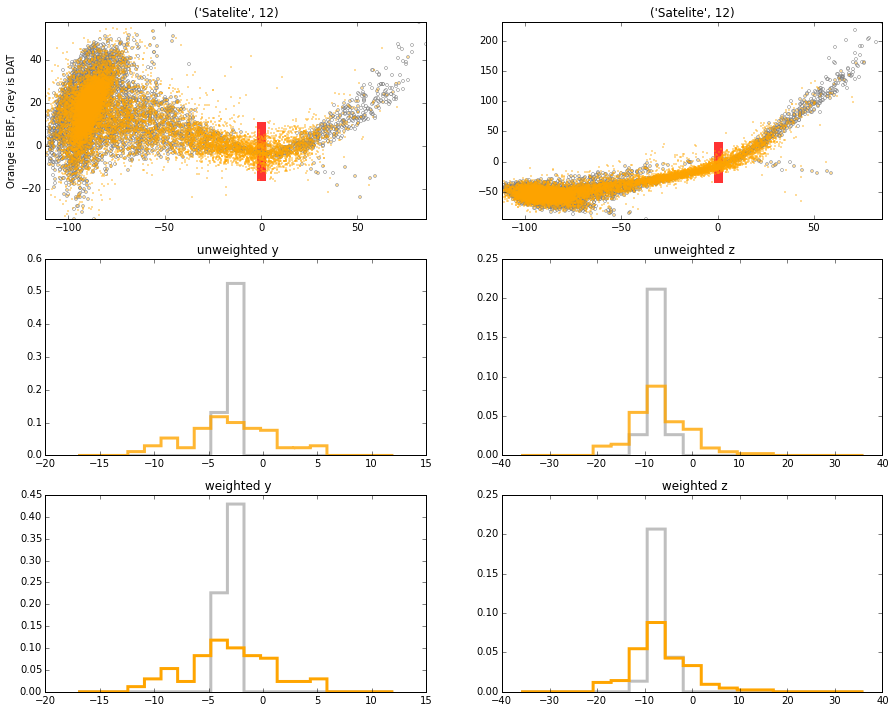

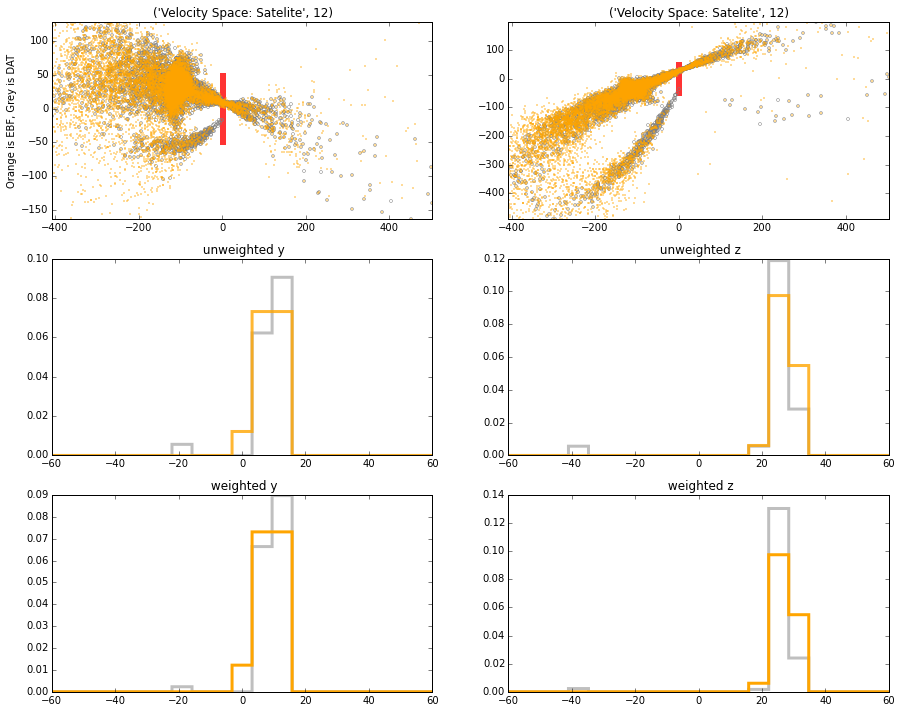

In [582]:
'''Plotting individual satellites with histogram'''
p=12
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot ..REAL SPACE
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,1,   # The limits of the box you look at
                                 -15,10,
                                 -30,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)


[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,1,   # The limits of the box you look at
                                 -50,50,
                                 -50,50]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)
plt.figure()

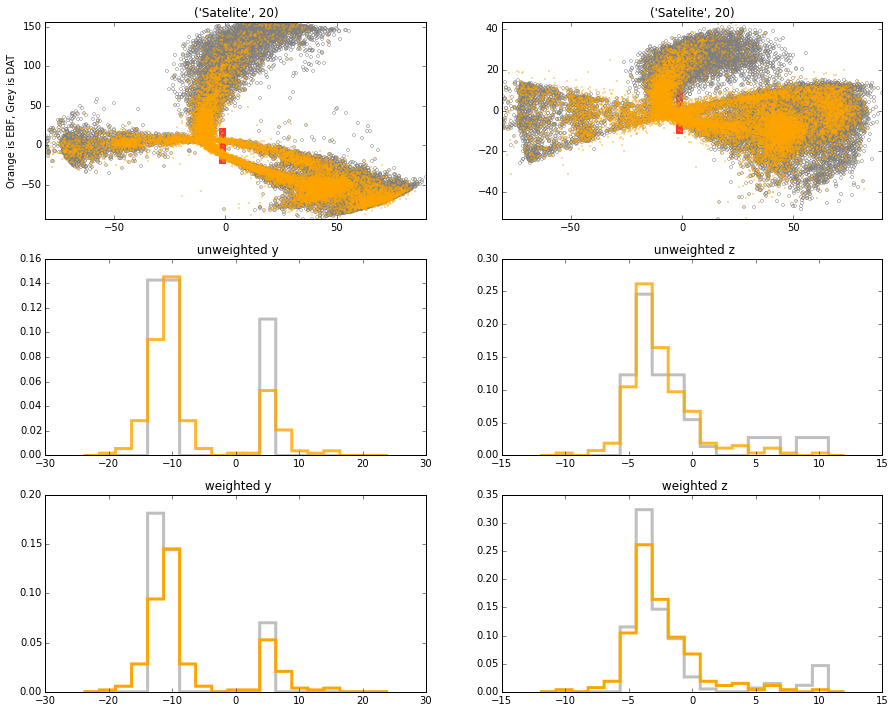

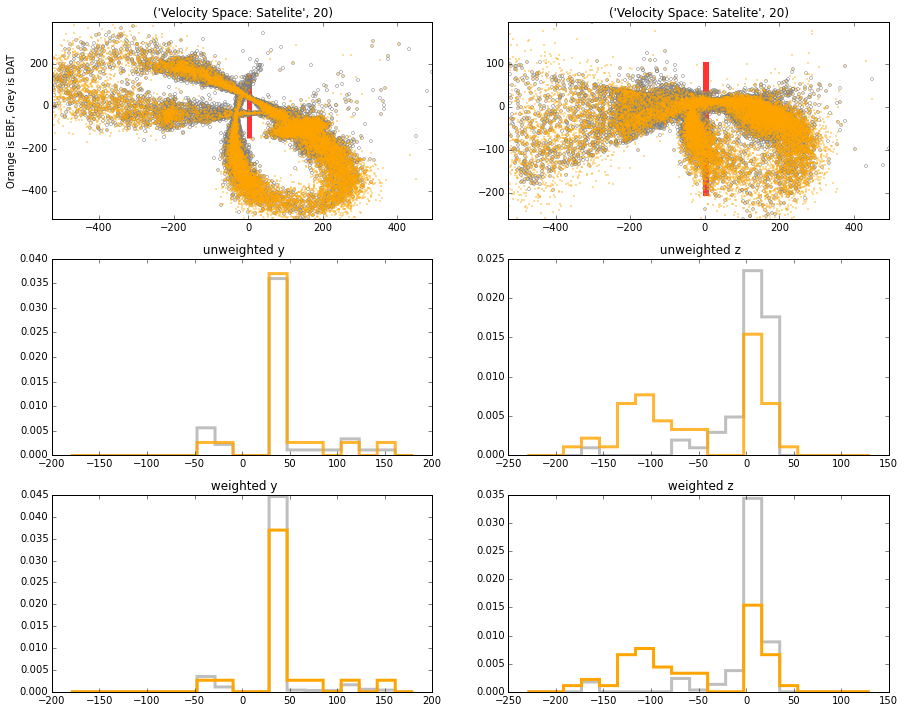

In [583]:
'''Plotting individual satellites with histogram'''
p=20
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-2,-1,   # The limits of the box you look at
                                 -20,20,
                                 -10,10]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)


[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[1,2,   # The limits of the box you look at
                                 -150,150,
                                 -200,100]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)
plt.figure()

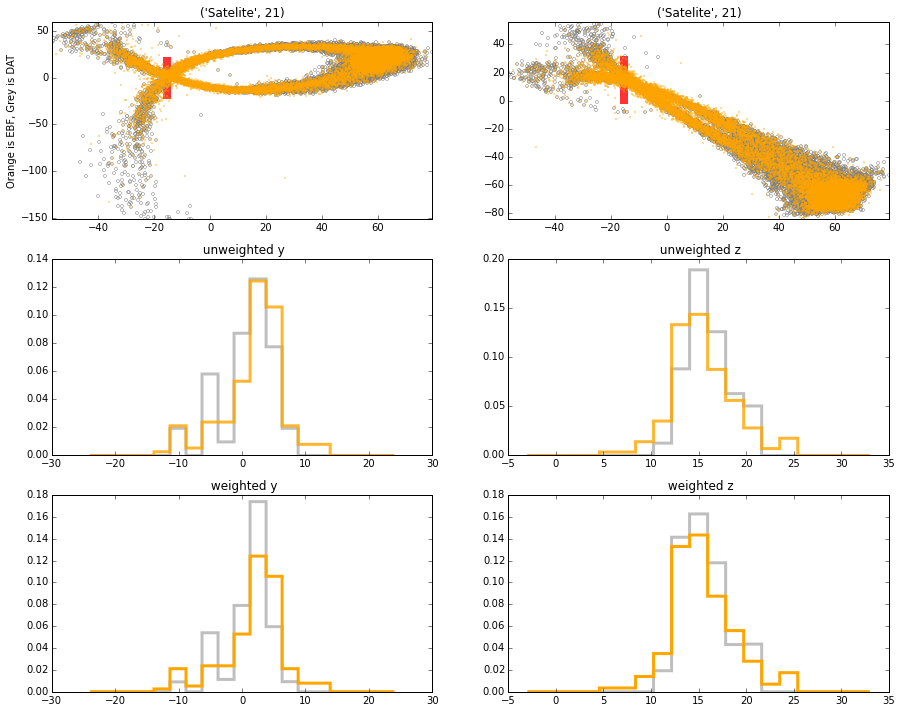

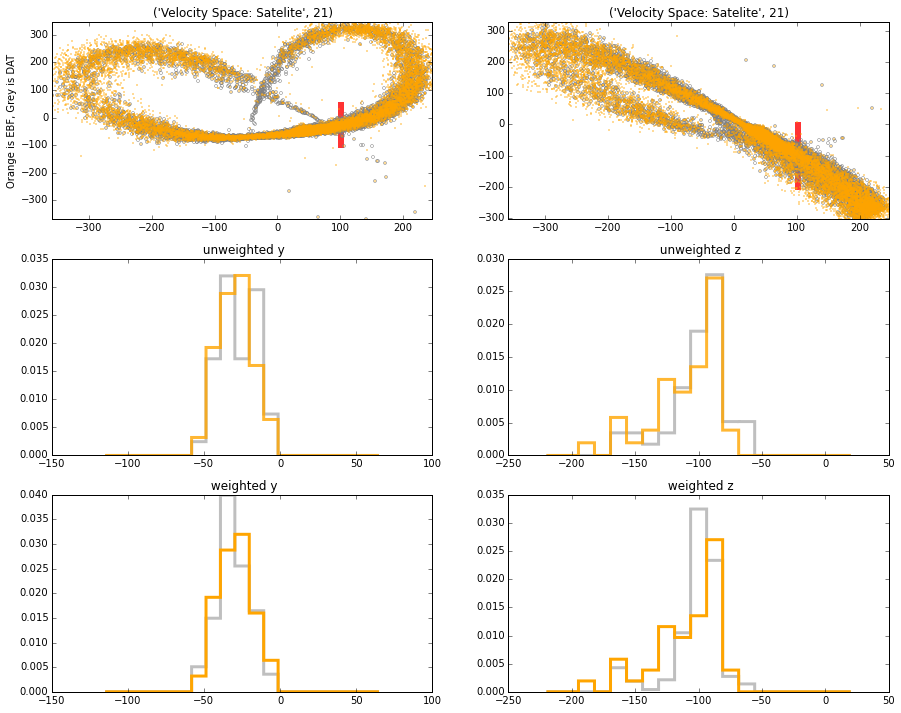

In [584]:
'''Plotting individual satellites with histogram'''
p=21
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-16,-15,   # The limits of the box you look at
                                 -20,20,
                                 0,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)


[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -100,50,
                                 -200,0]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)
plt.figure()

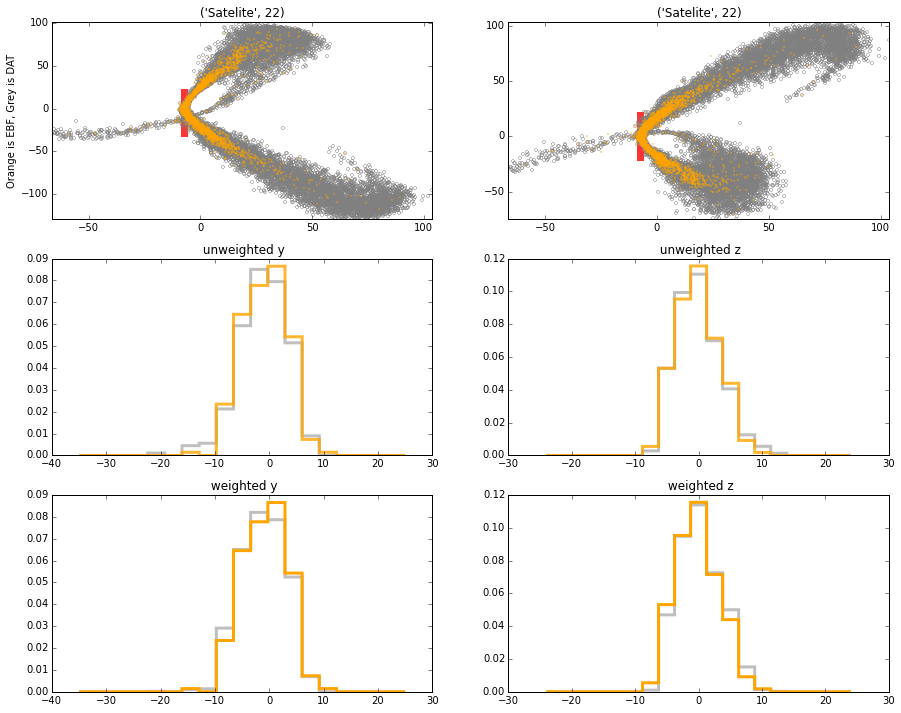

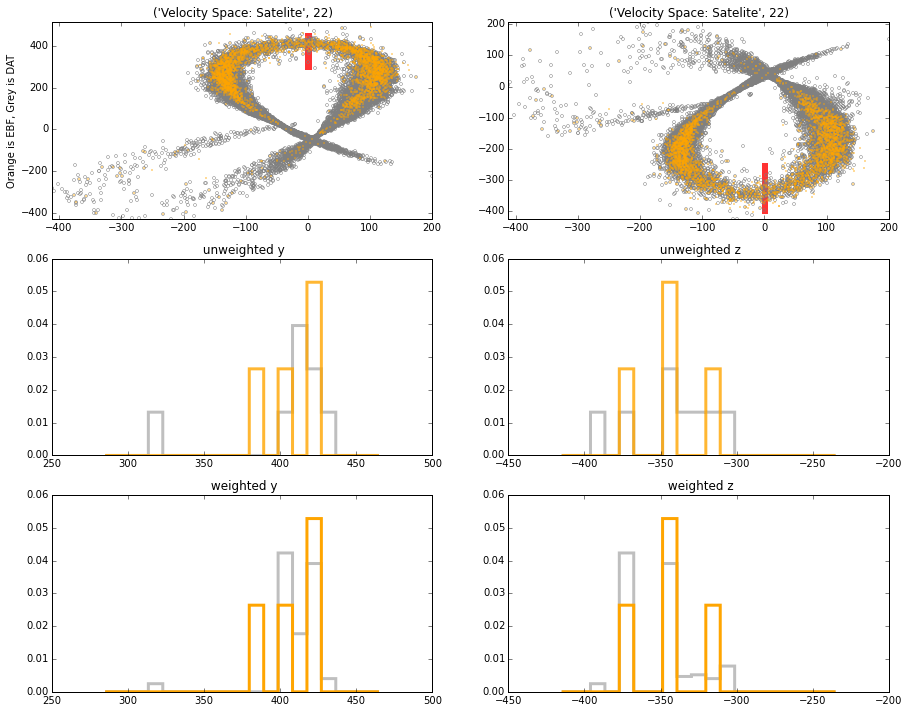

In [585]:
'''Plotting individual satellites with histogram'''
p=22
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-8,-7,   # The limits of the box you look at
                                 -30,20,
                                 -20,20]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)


[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,1,   # The limits of the box you look at
                                 300,450,
                                 -400,-250]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)


plt.figure()

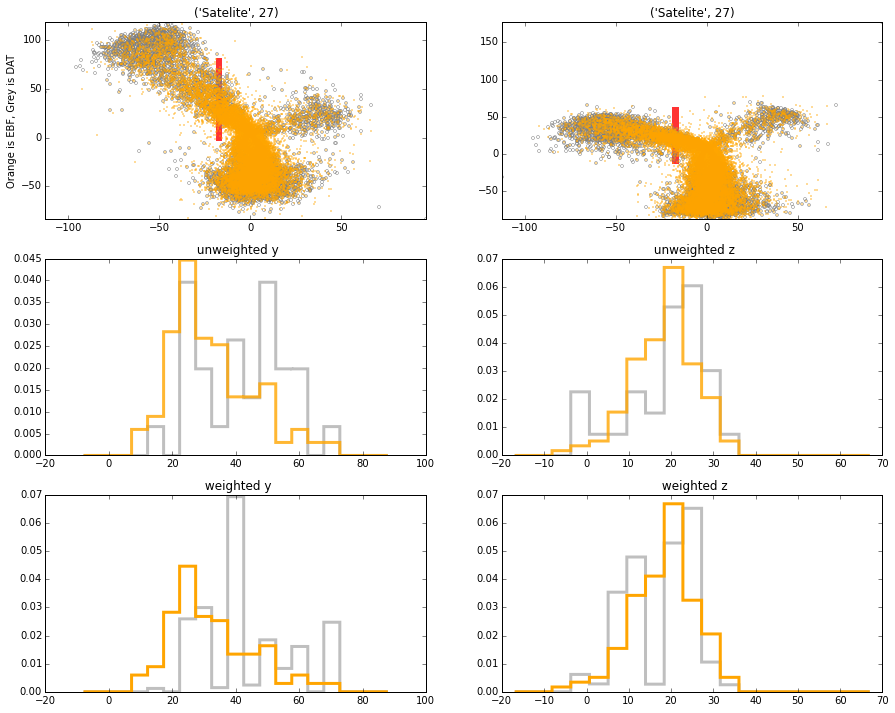

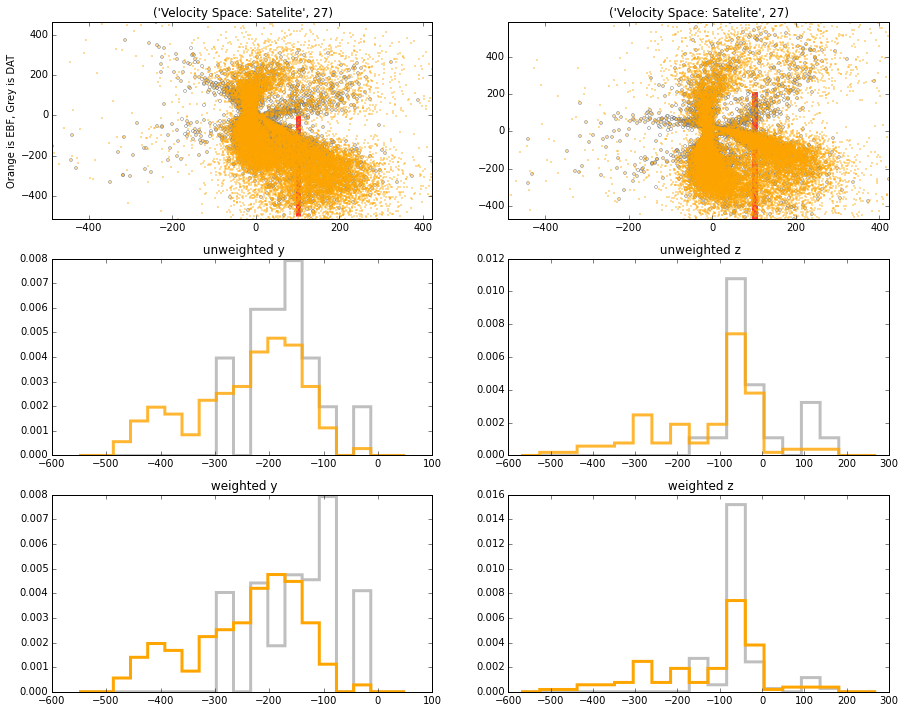

In [586]:
'''Plotting individual satellites with histogram'''
p=27
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-18,-17,   # The limits of the box you look at
                                 0,80,
                                 -10,60]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -500,0,
                                 -500,200]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

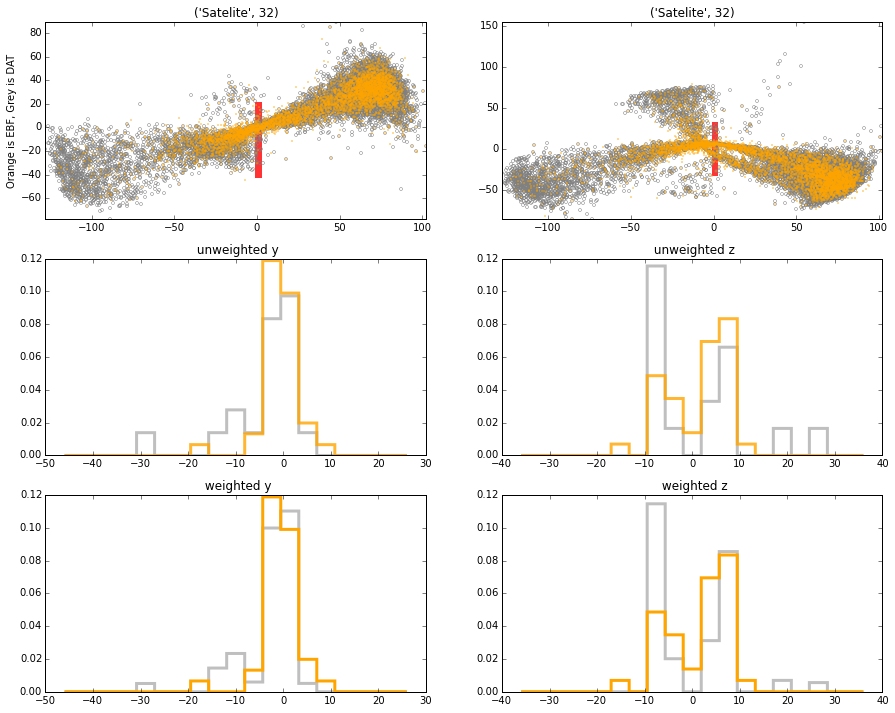

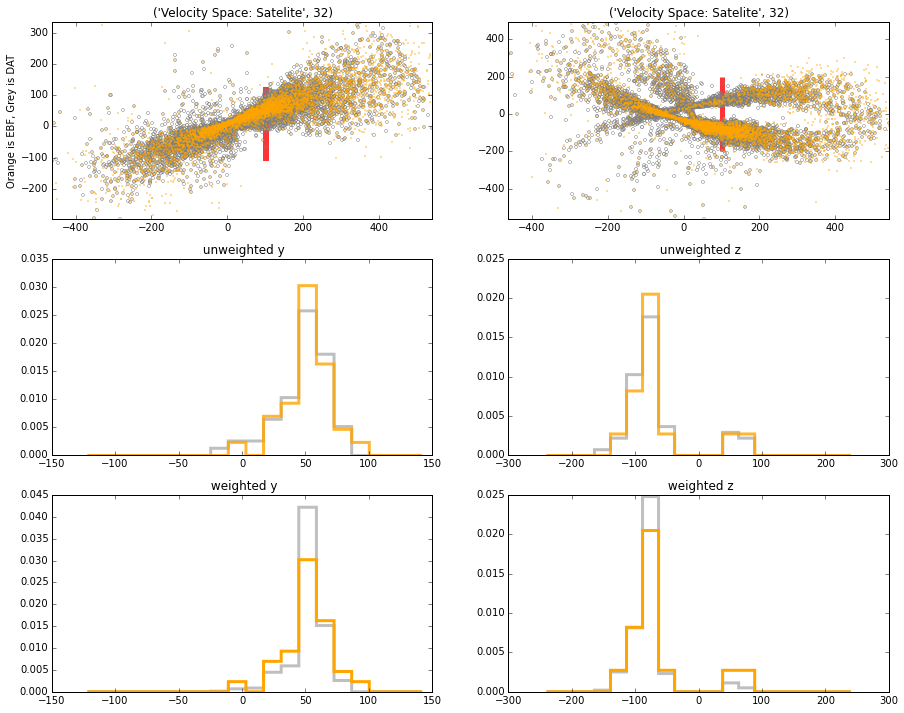

In [587]:
'''Plotting individual satellites with histogram'''
p=32
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -40,20,
                                 -30,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -100,120,
                                 -200,200]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

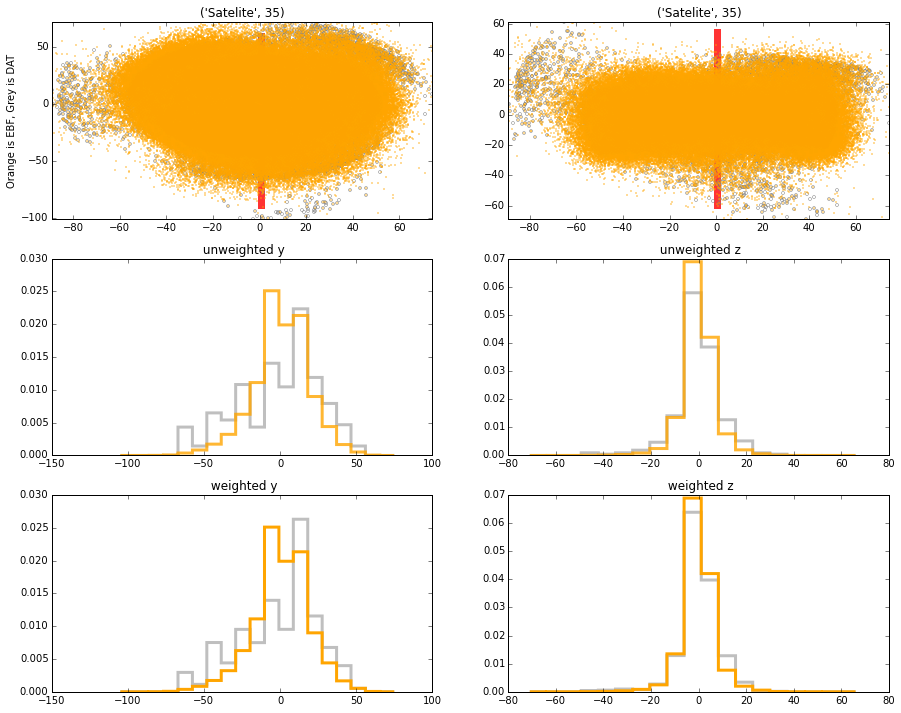

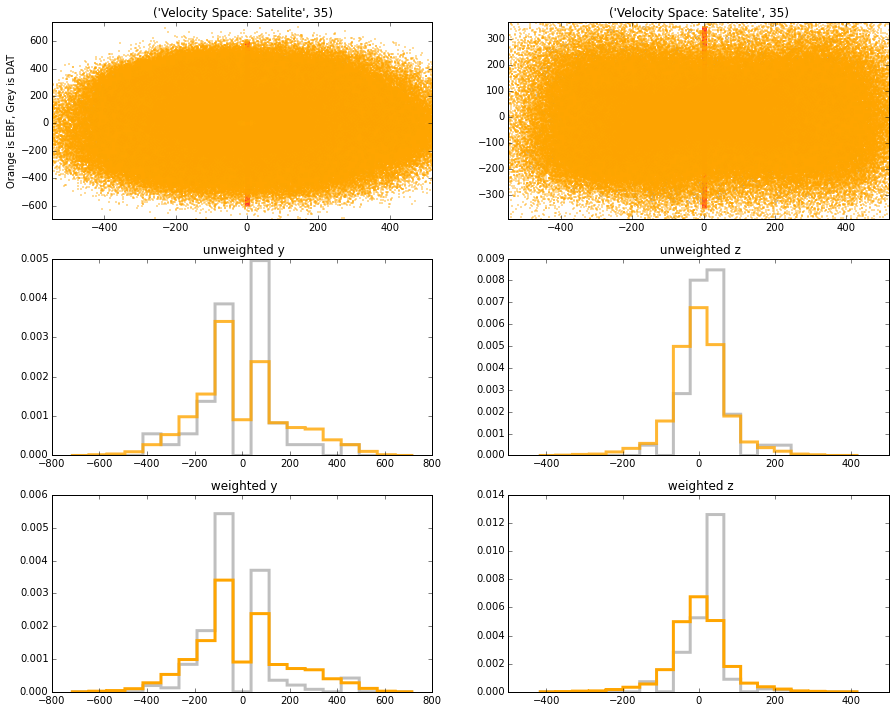

In [588]:
'''Plotting individual satellites with histogram'''
p=35
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -90,60,
                                 -60,55]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_EBF[p][5]),max(info_EBF[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -600,600,
                                 -350,350]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

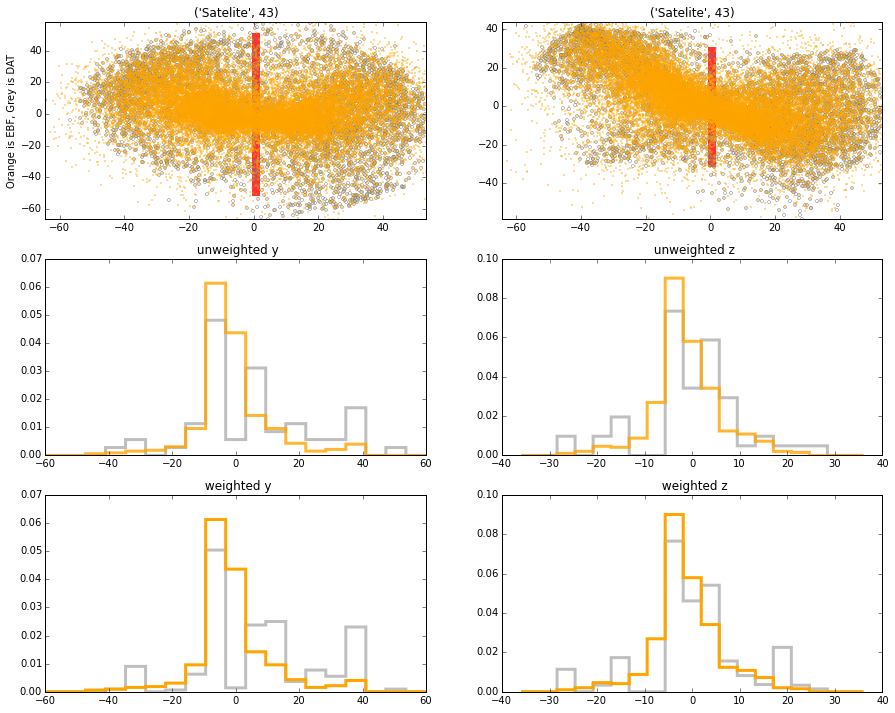

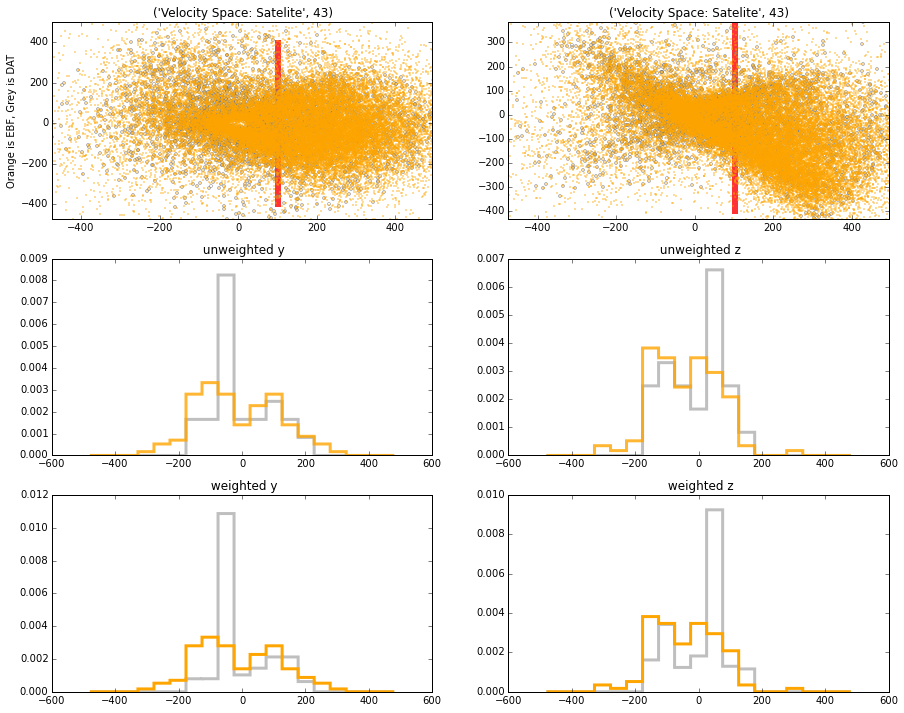

In [589]:
'''Plotting individual satellites with histogram'''
p=43
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -50,50,
                                 -30,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -400,400,
                                 -400,400]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

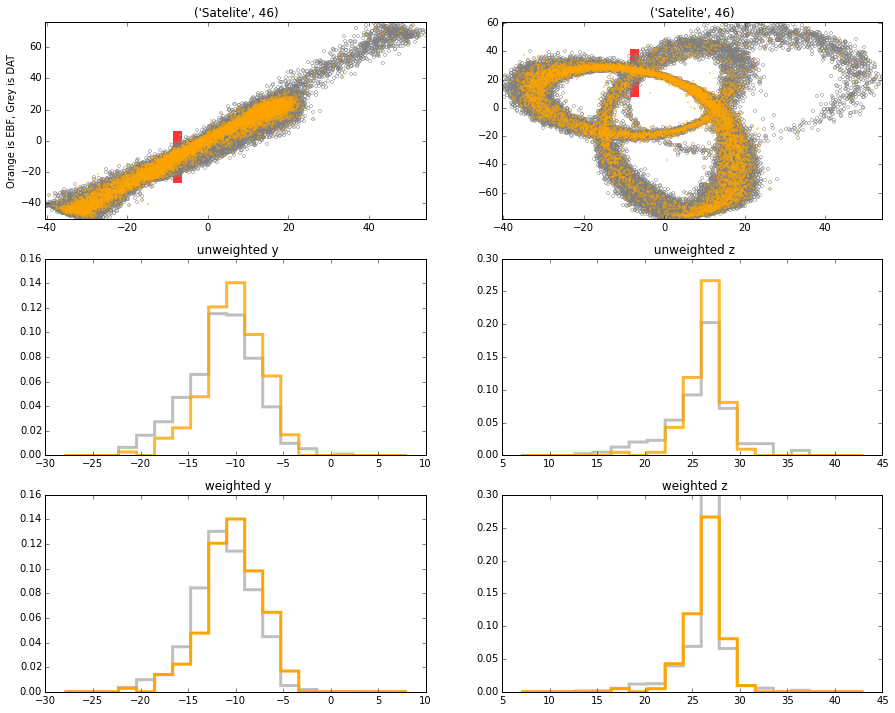

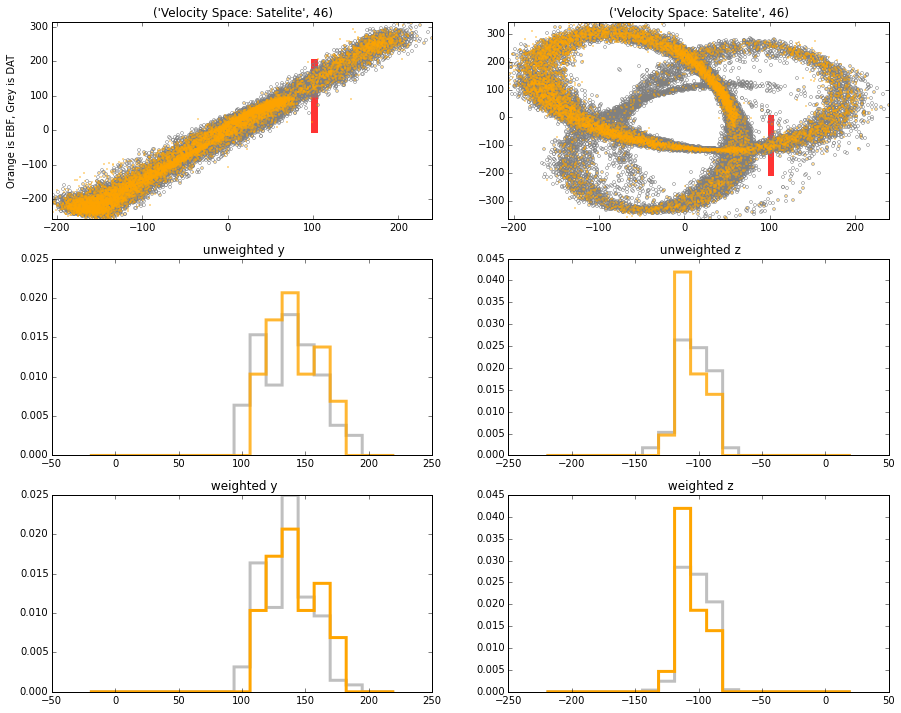

In [590]:
'''Plotting individual satellites with histogram'''
p=46
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-8,-7,   # The limits of the box you look at
                                 -25,5,
                                 10,40]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 0,200,
                                 -200,0]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

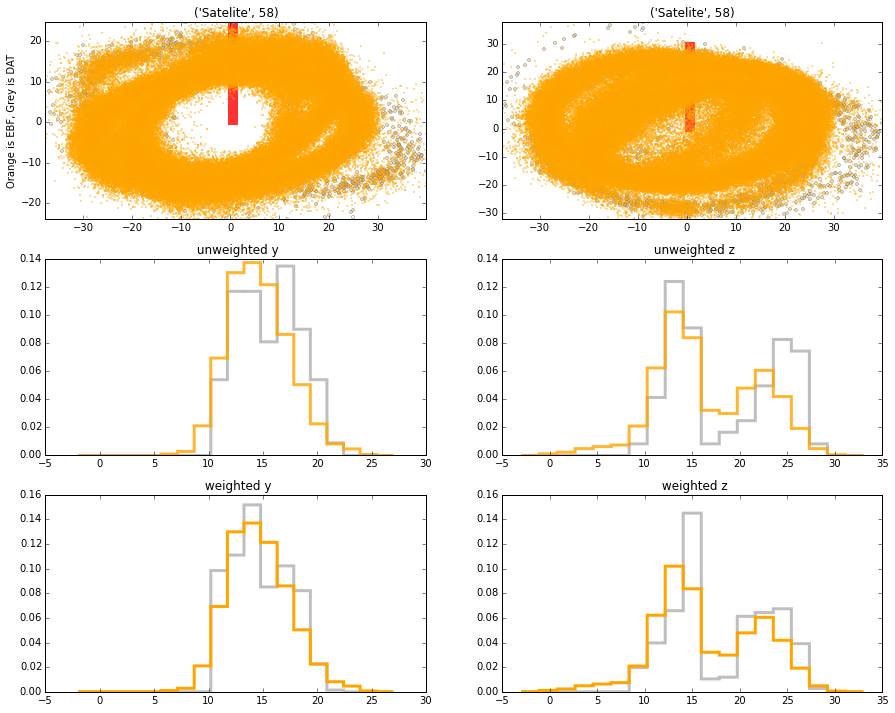

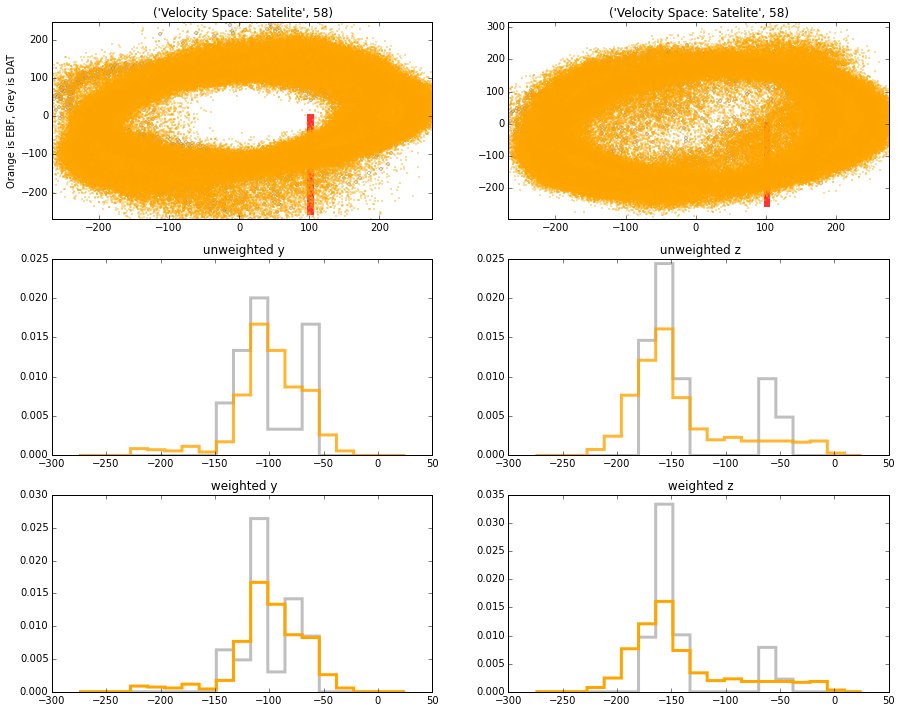

In [591]:
'''Plotting individual satellites with histogram'''
p=58
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 0,25,
                                 0,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_EBF[p][6]),max(info_EBF[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -250,0,
                                 -250,0]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

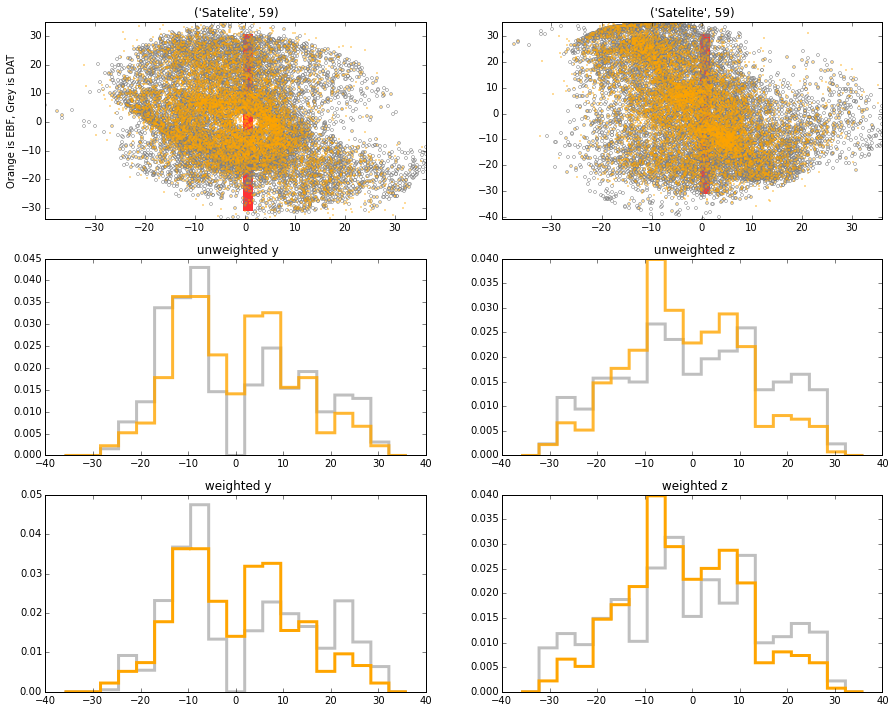

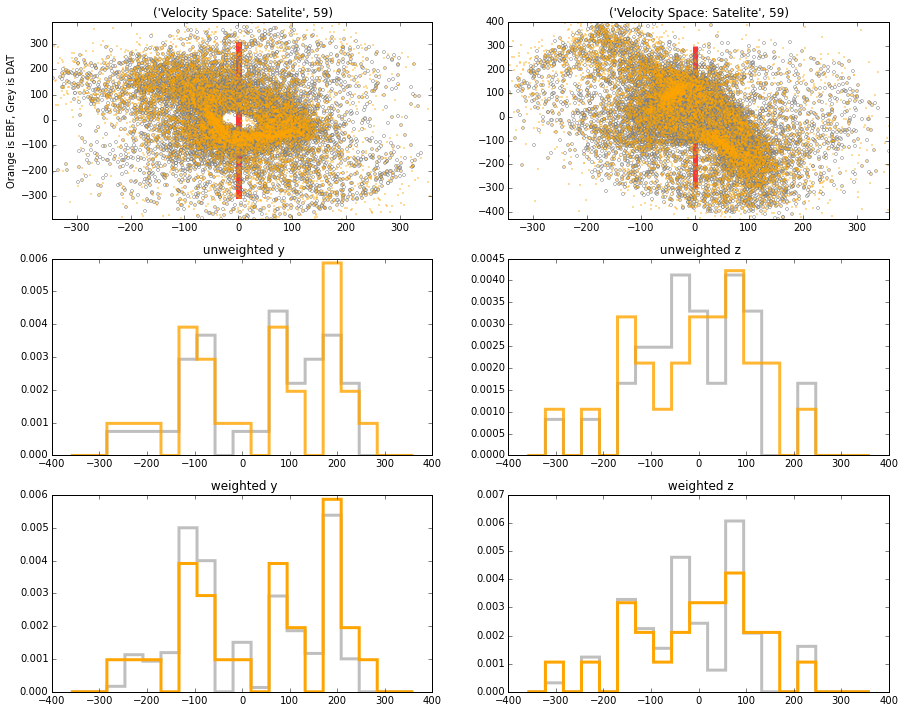

In [592]:
'''Plotting individual satellites with histogram'''
p=59
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -30,30,
                                 -30,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -300,300,
                                 -300,300]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()

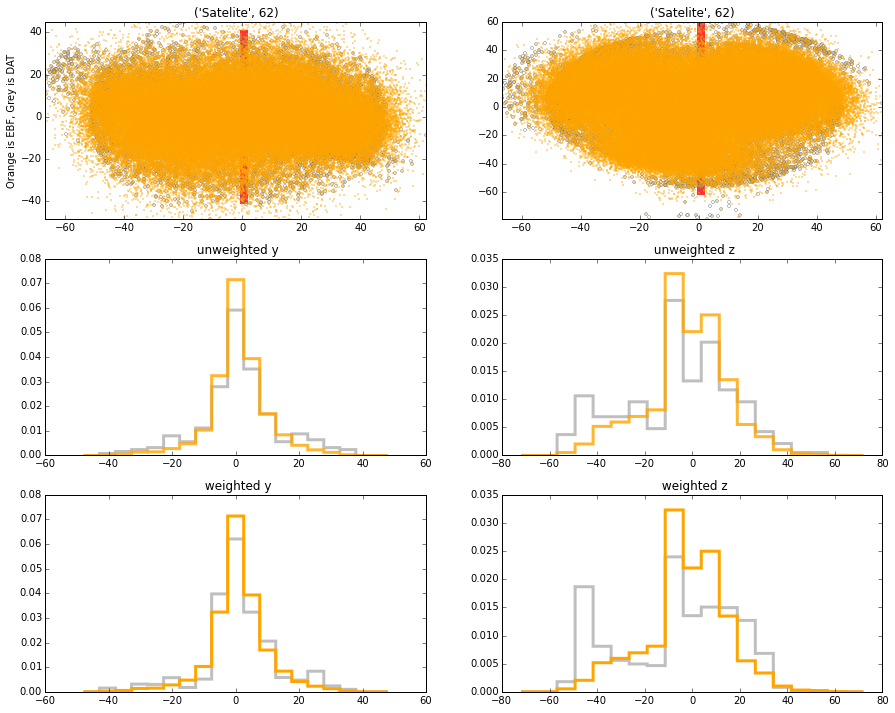

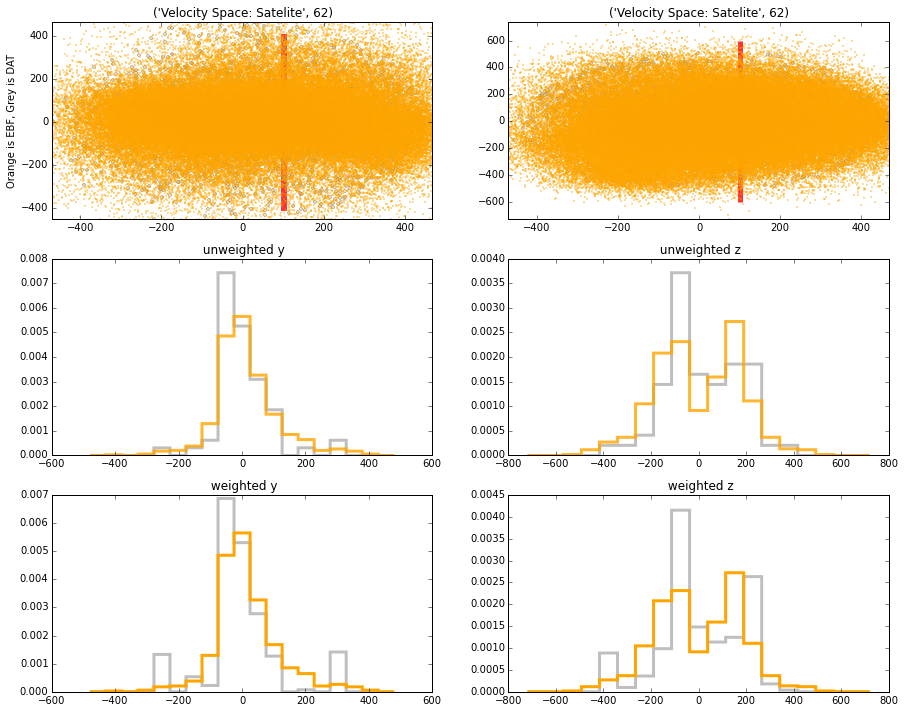

In [593]:
'''Plotting individual satellites with histogram'''
p=62
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -40,40,
                                 -60,60]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_EBF[p][6]),max(info_EBF[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -400,400,
                                 -600,600]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()
fig.savefig('62',bbox_inches='tight')

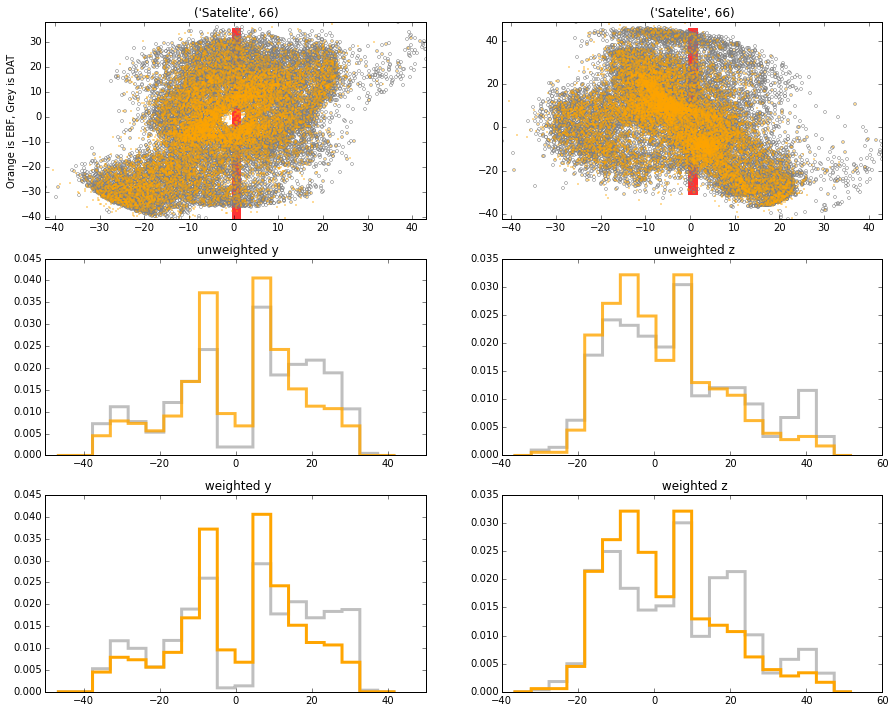

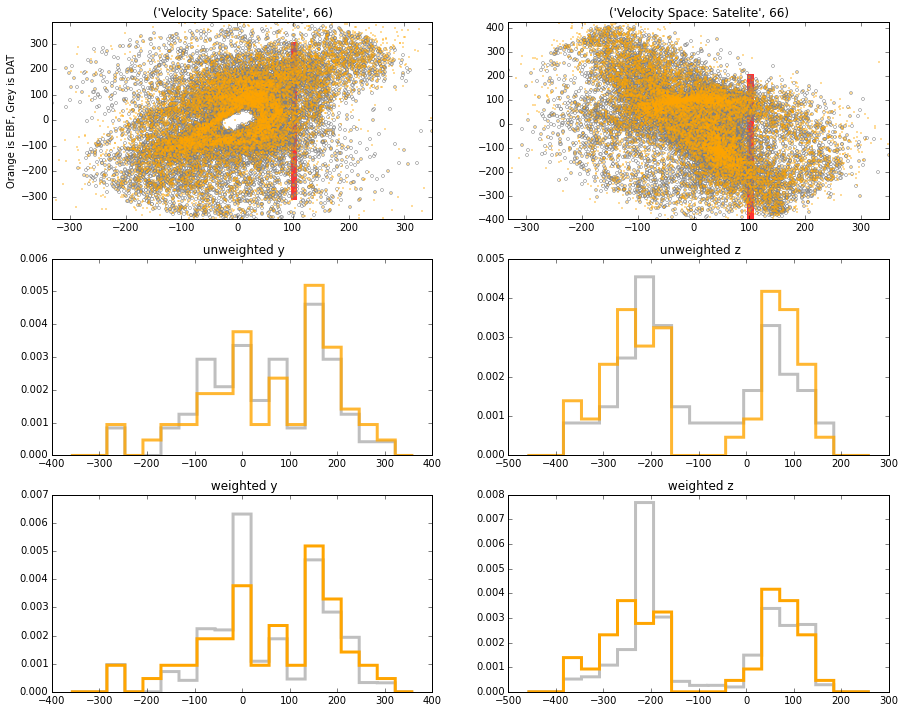

In [594]:
'''Plotting individual satellites with histogram'''
p=66
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -40,35,
                                 -30,45]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[100,102,   # The limits of the box you look at
                                 -300,300,
                                 -400,200]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()
fig.savefig('66',bbox_inches='tight')

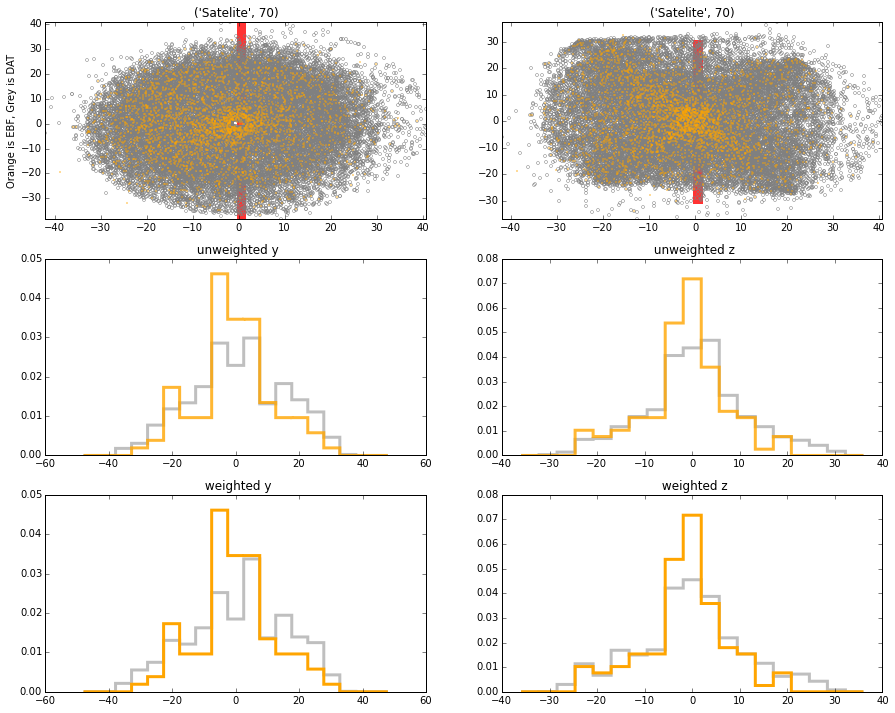

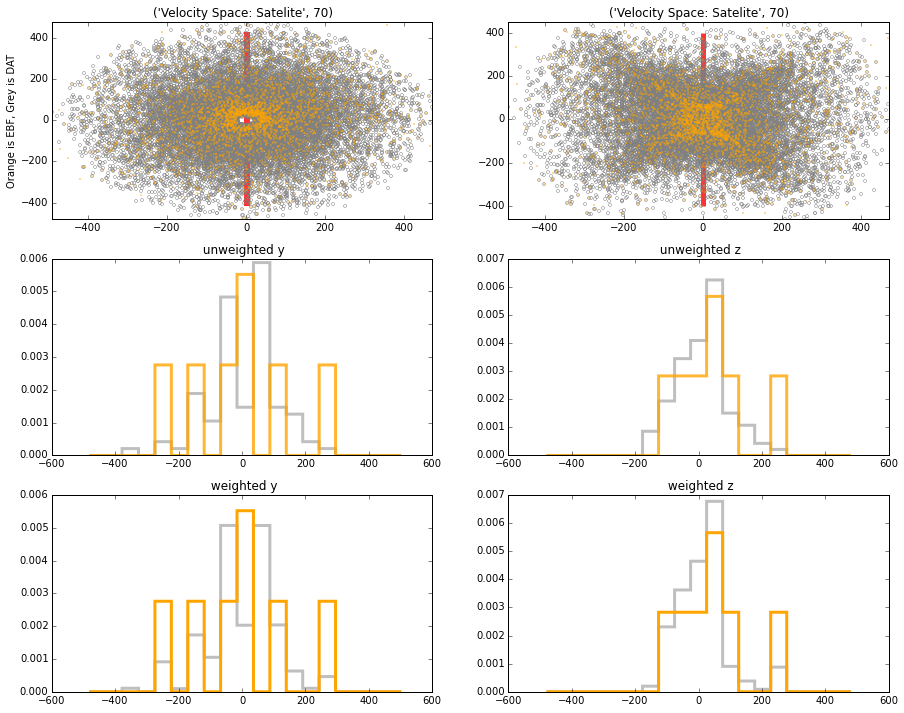

In [595]:
'''Plotting individual satellites with histogram'''
p=70
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -40,40,
                                 -30,30]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[1,2,   # The limits of the box you look at
                                 -400,420,
                                 -400,400]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()
fig.savefig('70',bbox_inches='tight')

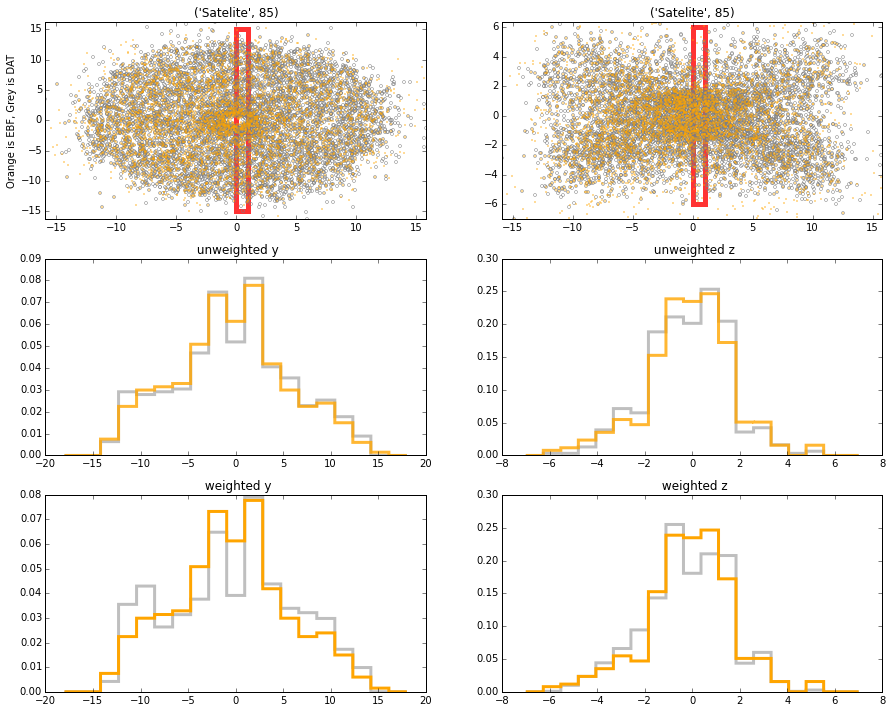

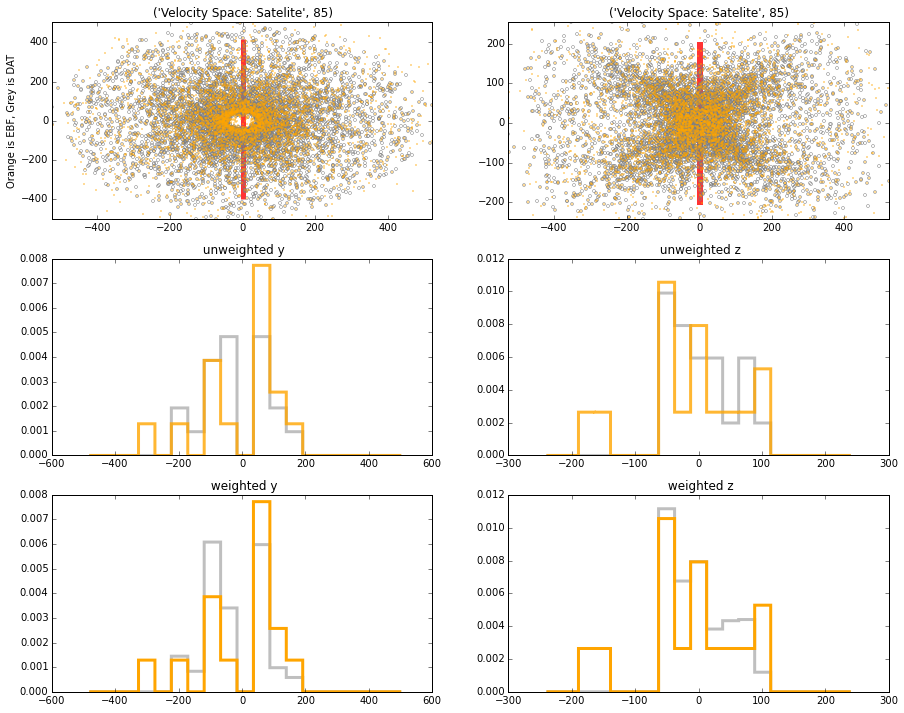

In [596]:
'''Plotting individual satellites with histogram'''
p=85
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_DAT[p][1]),max(info_DAT[p][1]),
                                       min(info_DAT[p][2]),max(info_DAT[p][2])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[0,1,   # The limits of the box you look at
                                 -15,15,
                                 -6,6]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[1,2,   # The limits of the box you look at
                                 -400,420,
                                 -200,200]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()
fig.savefig('85',bbox_inches='tight')

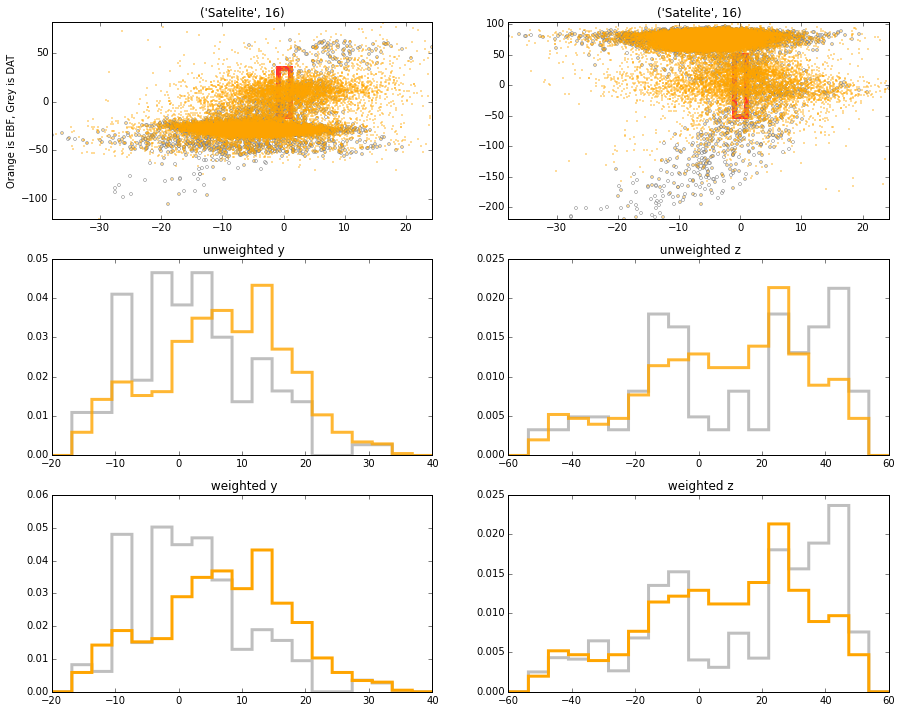

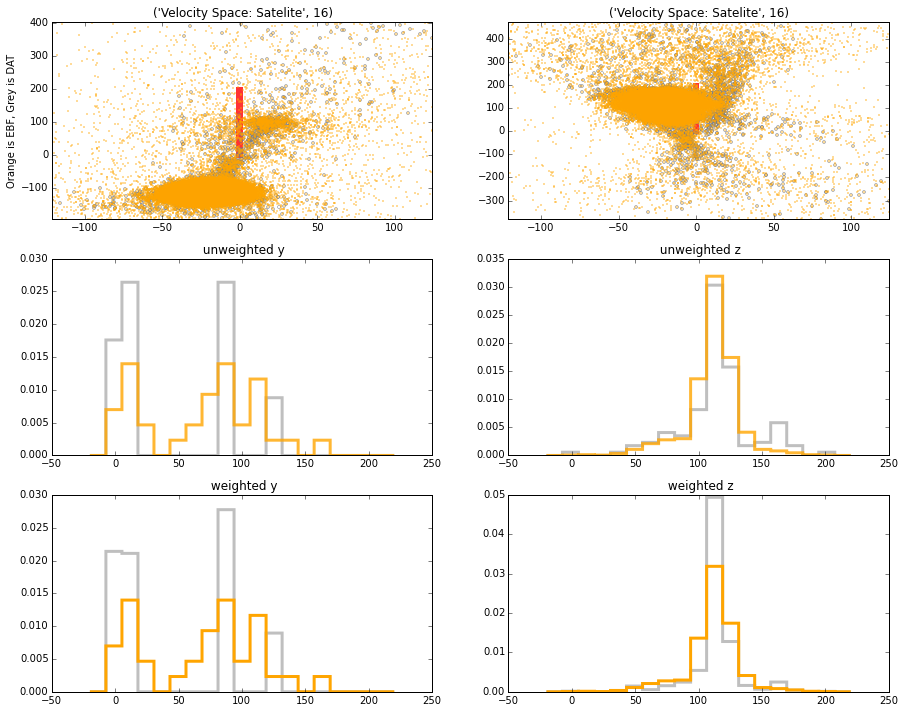

In [598]:
'''Plotting individual satellites with histogram'''
p=16
[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][0]),max(info_DAT[p][0]),   # The limits of the plot
                                       min(info_EBF[p][1]),max(info_EBF[p][1]),
                                       min(info_EBF[p][2]),max(info_EBF[p][2])
                                      ]

[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,1,   # The limits of the box you look at
                                 -15,35,
                                 -50,50]
plot_only_me_w_hist(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

[xstart,xend,ystart,yend,zstart,zend]=[min(info_DAT[p][4]),max(info_DAT[p][4]),   # The limits of the plot .. VEL SPACE
                                       min(info_DAT[p][5]),max(info_DAT[p][5]),
                                       min(info_DAT[p][6]),max(info_DAT[p][6])
                                      ]
[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,0,   # The limits of the box you look at
                                 0,200,
                                 0,200]
plot_only_me_w_hist_Velocity(p,xstart,xend,ystart,yend,zstart,zend,
                    xlow,xupp,ylow,yupp,zlow,zupp)

plt.figure()
fig.savefig('16.png',bbox_inches='tight')


[[ -3.8965  -3.6926  -7.6732 ...,  -9.3769   2.5582   2.1344]
 [-28.212  -23.627  -29.043  ..., -30.34   -24.966   12.767 ]
 [ 75.444   74.095   79.596  ...,  84.241   70.726   16.619 ]]
[[  -9.0554  -30.425    -9.5069 ...,  -18.888   -10.265   -16.961 ]
 [-110.21   -102.07   -100.44   ..., -136.11    -84.346  -147.95  ]
 [ 117.01    102.82    126.24   ...,  148.65     84.678   378.64  ]]


[[ 75.444   74.095   79.596  ...,  84.241   70.726   16.619 ]
 [-28.212  -23.627  -29.043  ..., -30.34   -24.966   12.767 ]
 [ -3.8965  -3.6926  -7.6732 ...,  -9.3769   2.5582   2.1344]]
[[-28.212  -23.627  -29.043  ..., -30.34   -24.966   12.767 ]
 [  3.8965   3.6926   7.6732 ...,   9.3769  -2.5582  -2.1344]
 [ 75.444   74.095   79.596  ...,  84.241   70.726   16.619 ]]


[ 75.444  74.095  79.596 ...,  84.241  70.726  16.619]


[-28.212 -23.627 -29.043 ..., -30.34  -24.966  12.767]
[ 3.8965  3.6926  7.6732 ...,  9.3769 -2.5582 -2.1344]
[ 75.444  74.095  79.596 ...,  84.241  70.726  16.619]


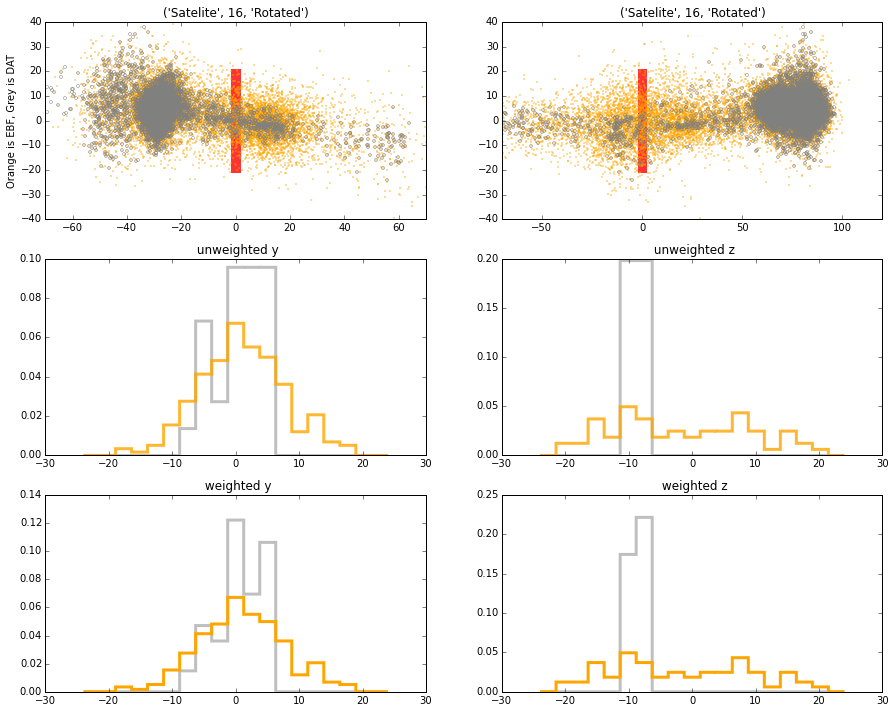

In [602]:
'''Let me rotate it'''

p=16


p_space = np.array([info_DAT[p][0],info_DAT[p][1],info_DAT[p][2]])                                    
v_space = np.array([info_DAT[p][4],info_DAT[p][5],info_DAT[p][6]])
p_spaceE = np.array([info_EBF[p][0],info_EBF[p][1],info_EBF[p][2]])                                    
v_spaceE = np.array([info_EBF[p][4],info_EBF[p][5],info_EBF[p][6]])

print p_space
print v_space
print '\n'

p_space = p_space.T
v_space = v_space.T
p_spaceE = p_spaceE.T
v_spaceE = v_spaceE.T

#print p_space
#print v_space

rotate_y_x = np.array([[0, 0, 1] , [0 ,1 ,0], [1 ,0, 0]])
rotate_z_x = np.array([[0, -1, 0] , [1 ,0 ,0], [0 ,0, 1]])
#print rotate_y_x
#print rotate_z_x

p_rotated_y_x = np.dot(p_space,rotate_y_x)
p_rotated_z_x = np.dot(p_space,rotate_z_x)
v_rotated_y_x = np.dot(v_space,rotate_y_x)
v_rotated_z_x = np.dot(v_space,rotate_z_x)
p_rotated_y_x = p_rotated_y_x.T
p_rotated_z_x = p_rotated_z_x.T
v_rotated_y_x = v_rotated_y_x.T
v_rotated_z_x = v_rotated_z_x.T



p_rotated_y_xE = np.dot(p_spaceE,rotate_y_x)
p_rotated_z_xE = np.dot(p_spaceE,rotate_z_x)
v_rotated_y_xE = np.dot(v_spaceE,rotate_y_x)
v_rotated_z_xE = np.dot(v_spaceE,rotate_z_x)
p_rotated_y_xE = p_rotated_y_xE.T
p_rotated_z_xE = p_rotated_z_xE.T
v_rotated_y_xE = v_rotated_y_xE.T
v_rotated_z_xE = v_rotated_z_xE.T



print p_rotated_y_x
print p_rotated_z_x
print '\n'
print p_rotated_y_x[0,:]
print '\n'
#print v_rotated_y_x
#print v_rotated_z_x

a = info_DAT[p][0]
b = info_DAT[p][1]
c = info_DAT[p][2]
d = info_DAT[p][4]
e = info_DAT[p][5]
f = info_DAT[p][6]
aE = info_EBF[p][0]
bE = info_EBF[p][1]
cE = info_EBF[p][2]
dE = info_EBF[p][4]
eE = info_EBF[p][5]
fE = info_EBF[p][6]


cc = p_rotated_y_x[0,:]
aa = p_rotated_y_x[1,:]
bb = p_rotated_z_x[1,:]
ff = v_rotated_y_x[0,:]
dd = v_rotated_y_x[1,:]
ee = v_rotated_z_x[1,:]

ccE = p_rotated_y_xE[0,:]
aaE = p_rotated_y_xE[1,:]
bbE = p_rotated_z_xE[1,:]
ffE = v_rotated_y_xE[0,:]
ddE = v_rotated_y_xE[1,:]
eeE = v_rotated_z_xE[1,:]

print aa
print bb
print cc

[xlow,xupp,ylow,yupp,zlow,zupp]=[-1,1,   # The limits of the box you look at
                                 -20,20,
                                 -20,20]
x_hist = []
y_hist = []
z_hist = []
m_hist_y = []
m_hist_z = []
         
for i in range(len(aa)):
    if aa[i] >= xlow and aa[i]<=xupp:
        if bb[i] >= ylow and bb[i]<=yupp:
            y_hist.append(bb[i])
            m_hist_y.append(info_DAT[p][3][i])
        if cc[i] >= zlow and cc[i]<=zupp:
            z_hist.append(cc[i])
            m_hist_z.append(info_DAT[p][3][i])
           
x_al_hist = []
y_al_hist = []
z_al_hist = []
m_al_hist_y = []
m_al_hist_z = []
    
for i in range(len(aaE)):
    if aaE[i] >= xlow and aaE[i]<=xupp:
        if bbE[i] >= ylow and bbE[i]<=yupp:
            y_al_hist.append(bbE[i])
            m_al_hist_y.append(info_EBF[p][3][i])
        if ccE[i] >= zlow and ccE[i]<=zupp:
            z_al_hist.append(ccE[i])
            m_al_hist_z.append(info_EBF[p][3][i])


title = 'Satelite',p,'Rotated'
side_title = 'Orange is EBF, Grey is DAT'
plt.rcParams['figure.figsize']=(15,12)
fig,ax = plt.subplots(3,2)

ax[0,0].plot(aaE,bbE,'o',ms=1,alpha=0.05,color='none',mec='orange')  
ax[0,0].plot(aa,bb,'o',ms=3,alpha=0.03,color='none',mec='grey') 
ax[0,0].set_title(title)
ax[0,0].set_ylabel(side_title)
ax[0,0].set_xlim(-70,70)
ax[0,0].set_ylim(-40,40)
ax[0,0].add_patch(
            patches.Rectangle(
            (xlow, ylow),       # (x,y)
             xupp-xlow,         # width
             yupp-ylow,          # height
             facecolor = 'None',edgecolor = 'red',alpha=0.8,linewidth=5
            ))
plt.figure()


#across y_hist
hist_low_y = ylow - (yupp-ylow)/10                                                                                                                              
hist_upp_y = yupp + (yupp-ylow)/10      
bins = np.linspace(hist_low_y,hist_upp_y,20)
ax[1,0].set_title(' unweighted y ')
ax[1,0].hist(y_hist,          #DAT
                 normed=True, 
                 bins = bins,
                 histtype='step',
                 color = 'grey',
                 alpha = 0.5, 
                 linewidth=3 )
ax[1,0].hist(y_al_hist,       #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'orange',
                 alpha = 0.8, 
                 linewidth=3) 

           
ax[2,0].set_title(' weighted y ')
ax[2,0].hist(y_hist,          #DAT
                 normed=True, 
                 bins = bins, 
                 histtype='step', 
                 color = 'grey',
                 alpha = 0.5, 
                 linewidth=3
                 ,weights = m_hist_y 
                )
ax[2,0].hist(y_al_hist,       #EBF
                 normed=True,
                 bins = bins,
                 histtype='step', 
                 color = 'orange', 
                 alpha = 1, 
                 linewidth=3
                 #,weights = m_al_hist_y
                 )


ax[0,1].plot(ccE,bbE,'o',ms=1,alpha=0.05,color='none',mec='orange') 
ax[0,1].plot(cc,bb,'o',ms=3,alpha=0.03,color='none',mec='grey')
ax[0,1].set_title(title)
ax[0,1].set_xlim(-70,120)
ax[0,1].set_ylim(-40,40)
ax[0,1].add_patch(
            patches.Rectangle(
            (xlow, ylow),       # (x,y)
             xupp-xlow,         # width
             yupp-ylow,          # height
             facecolor = 'None',edgecolor = 'red',alpha=0.8,linewidth=5
            ))
# across z_hist
hist_low_z = zlow - (zupp-zlow)/10
hist_upp_z= zupp + (zupp-zlow)/10
bins = np.linspace(hist_low_z,hist_upp_z,20)
ax[1,1].set_title(' unweighted z ')
ax[1,1].hist(z_hist,         #DAT
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'grey',
                 alpha = 0.5,
                 linewidth=3)
ax[1,1].hist(z_al_hist,      #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step',
                 color = 'orange', 
                 alpha = 0.8, 
                 linewidth=3) 
    
ax[2,1].set_title(' weighted z ')
ax[2,1].hist(z_hist,         #DAT
                 normed=True, 
                 bins = bins,
                 histtype='step', 
                 color = 'grey',
                 alpha = 0.5,  
                 linewidth=3
                 ,weights = m_hist_z
                )
ax[2,1].hist(z_al_hist,      #EBF
                 normed=True, 
                 bins = bins, 
                 histtype='step', 
                 color = 'orange', 
                 alpha = 1, 
                 linewidth=3
                 #,weights = m_al_hist_z
                
                )
fig.savefig('16_rotated.png',bbox_inches='tight')

In [603]:
12,16,20,21,27,30,32,35,43,58,59,62,66,70,85

(12, 16, 20, 21, 27, 30, 32, 35, 43, 58, 59, 62, 66, 70, 85)